In [1]:
import pandas as pd
import numpy as np
from scipy.stats import gaussian_kde
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
import os
import seaborn as sns
import anndata as ad
import scanpy as sc
import biomart
import scanorama
from sklearn.model_selection import LeaveOneOut
import cycler

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.8.0 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.7


In [3]:
Puram_final_adata = sc.read_h5ad('./Puram/Puram_scanpy.h5ad')
Puram_final_adata.uns['log1p']["base"] = None
Puram_final_adata

AnnData object with n_obs × n_vars = 4484 × 21196
    obs: 'Cell_type', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'doublet_scores', 'predicted_doublets', 'doublet_info'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [109]:
# HNSCC 19-26 are HPV+ samples

In [4]:
# read in Cillo annotation
sample_meta = pd.read_csv("/home/cke/Cillo/cillo_immunity_fitsne_cell_annotations_220629.csv")
sample_meta

,cell_barcodes,FItSNE_1,FItSNE_2,cell_type_annotations,patient_id,sample_type
0,AAACCTGCACAGACTT,-0.088718,-3.949469,cd8.cells,HD_1,PBMC
1,AAACCTGCATCGGTTA,7.162101,-25.850694,cd14.cells,HD_1,PBMC
2,AAACCTGTCAAGCCTA,1.154112,-4.324750,cd8.cells,HD_1,PBMC
3,AAACCTGTCTTAACCT,2.083668,-12.106379,cd8.cells,HD_1,PBMC
4,AAACGGGCAATAGCGG,0.880007,-2.571512,cd8.cells,HD_1,PBMC
...,...,...,...,...,...,...
131219,TTTGTCAAGGCTATCT,25.536454,6.505171,cd8.cells,HNSCC_26,TIL
131220,TTTGTCACAGTATAAG,18.480221,46.980300,mast.cells,HNSCC_26,TIL
131221,TTTGTCAGTGCCTGGT,32.800583,29.582970,cd8.cells,HNSCC_26,TIL
131222,TTTGTCATCAGTTCGA,45.879116,13.091147,pdc.cells,HNSCC_26,TIL


In [5]:
sample_meta['cell_type_annotations'].value_counts()

tconv.cells    41889
cd8.cells      32734
cd14.cells     21737
b.cells        16736
nk.cells        8108
cd16.cells      3946
treg.cells      3751
pdc.cells       1094
dc.cells         916
mast.cells       313
Name: cell_type_annotations, dtype: int64

## 1. Processing Cillo et al scRNAseq data

In [6]:
results_file = '/home/cke/Cillo/Cillo_scanpy.h5ad'  # the file that will store the analysis results

In [7]:
# 63 samples in total, 26 PBMC and 26 ti immune cells, 6 healthy PBMC, 5 healthy tonsil tissue resident immune cells
# get paths of all samples' 10x files
matrix_name_cillo = []
feature_name_cillo = []
barcode_name_cillo = []

probe = os.walk("/home/cke/Cillo")
for path,dir_list,file_list in probe:
    for file_name in file_list:
        name = os.path.join(path,file_name)
        if name.endswith('TIL_matrix.mtx.gz'): # exclude PBMCs and HDs
            matrix_name_cillo.append(name.split('matrix')[0]+'matrix.mtx.gz')
            feature_name_cillo.append(name.split('matrix')[0]+'genes.tsv.gz')
            barcode_name_cillo.append(name.split('matrix')[0]+'barcodes.tsv.gz')
print(len(matrix_name_cillo))

26


In [48]:
matrix_name_cillo

['/home/cke/Cillo/GEO_samples/GSM4138129_HNSCC_10_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138137_HNSCC_14_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138125_HNSCC_8_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138143_HNSCC_17_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138151_HNSCC_21_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138135_HNSCC_13_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138153_HNSCC_22_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138127_HNSCC_9_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138123_HNSCC_7_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138155_HNSCC_23_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138133_HNSCC_12_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138161_HNSCC_26_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138159_HNSCC_25_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_samples/GSM4138157_HNSCC_24_TIL_matrix.mtx.gz',
 '/home/cke/Cillo/GEO_s

In [51]:
adatas

[AnnData object with n_obs × n_vars = 1384 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 1919 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 917 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 3116 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 2553 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 1824 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 2453 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 5106 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 2346 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 2313 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 1905 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 3942 × 33694
     var: 'gene_symbols',
 AnnData object with n_obs × n_vars = 3802 × 33694
     var: 'gene_symbols',


### Create one merged object


In [92]:
# readin all samples and concat to one object with batches
# merging data directly without batch effect correction now
adatas = []
for i in range(len(matrix_name_cillo)):
    adata = sc.read(matrix_name_cillo[i],cache=True).transpose()
    adata.var_names = pd.read_csv(feature_name_cillo[i],sep='\t',header=None)[1].tolist()
    adata.var['gene_symbols'] = pd.read_csv(feature_name_cillo[i],sep='\t',header=None)[1].tolist()
    adata.obs_names = pd.read_csv(barcode_name_cillo[i],header=None)[0]
    adata.obs_names_make_unique()
    adata.var_names_make_unique()
    adatas.append(adata)
sc.logging.print_memory_usage()
final_adata = adatas[0].concatenate(adatas[1:])

... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138129_HNSCC_10_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138137_HNSCC_14_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138125_HNSCC_8_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138143_HNSCC_17_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138151_HNSCC_21_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138135_HNSCC_13_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138153_HNSCC_22_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138127_HNSCC_9_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138123_HNSCC_7_TIL_matrix.h5ad
... reading from cache file cache/home-cke-Cillo-GEO_samples-GSM4138155_HNSCC_23_TIL_matrix.h5ad
... reading from cache file cache

/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [93]:
dict_batch = {}
for i in range(0,len(adatas)):
    dict_batch[str(i)] = [j.split("/")[-1].rstrip('_gene.tsv.gz').split("_")[1]+"_"+j.split("/")[-1].rstrip('_gene.tsv.gz').split("_")[2] for j in feature_name_cillo][i]
    # get HNSCC_X batch id
final_adata.obs['batch'] = final_adata.obs['batch'].map(dict_batch)

In [94]:
dict_batch

{'0': 'HNSCC_10',
 '1': 'HNSCC_14',
 '2': 'HNSCC_8',
 '3': 'HNSCC_17',
 '4': 'HNSCC_21',
 '5': 'HNSCC_13',
 '6': 'HNSCC_22',
 '7': 'HNSCC_9',
 '8': 'HNSCC_7',
 '9': 'HNSCC_23',
 '10': 'HNSCC_12',
 '11': 'HNSCC_26',
 '12': 'HNSCC_25',
 '13': 'HNSCC_24',
 '14': 'HNSCC_5',
 '15': 'HNSCC_18',
 '16': 'HNSCC_20',
 '17': 'HNSCC_6',
 '18': 'HNSCC_2',
 '19': 'HNSCC_3',
 '20': 'HNSCC_4',
 '21': 'HNSCC_15',
 '22': 'HNSCC_1',
 '23': 'HNSCC_19',
 '24': 'HNSCC_16',
 '25': 'HNSCC_11'}

In [95]:
del(adatas)

In [96]:
# 26 PBMCs and TIL paired samples and 6 PBMCs+5 tissue resident immune cells healthy donors
print(final_adata.obs['batch'].value_counts())
final_adata

HNSCC_9     5106
HNSCC_26    3942
HNSCC_25    3802
HNSCC_24    3678
HNSCC_16    3630
HNSCC_17    3116
HNSCC_3     2868
HNSCC_11    2687
HNSCC_18    2651
HNSCC_21    2553
HNSCC_22    2453
HNSCC_7     2346
HNSCC_23    2313
HNSCC_2     2286
HNSCC_4     2043
HNSCC_14    1919
HNSCC_12    1905
HNSCC_15    1832
HNSCC_13    1824
HNSCC_6     1658
HNSCC_10    1384
HNSCC_1     1298
HNSCC_19    1168
HNSCC_20    1148
HNSCC_8      917
HNSCC_5      449
Name: batch, dtype: int64


AnnData object with n_obs × n_vars = 60976 × 33694
    obs: 'batch'
    var: 'gene_symbols'

<AxesSubplot:>

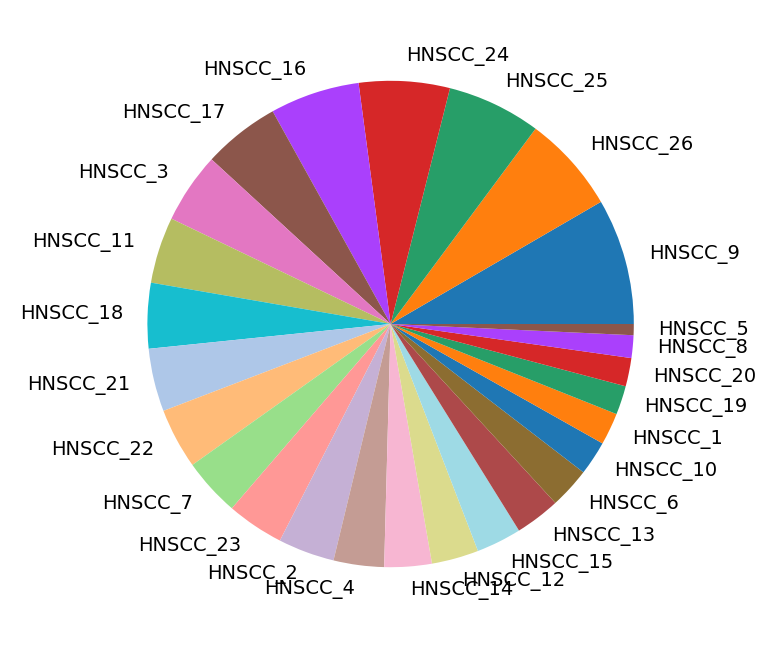

In [110]:
final_adata.obs['batch'].value_counts().plot(
    kind='pie',fontsize=7,ylabel='')

<AxesSubplot:xlabel='index'>

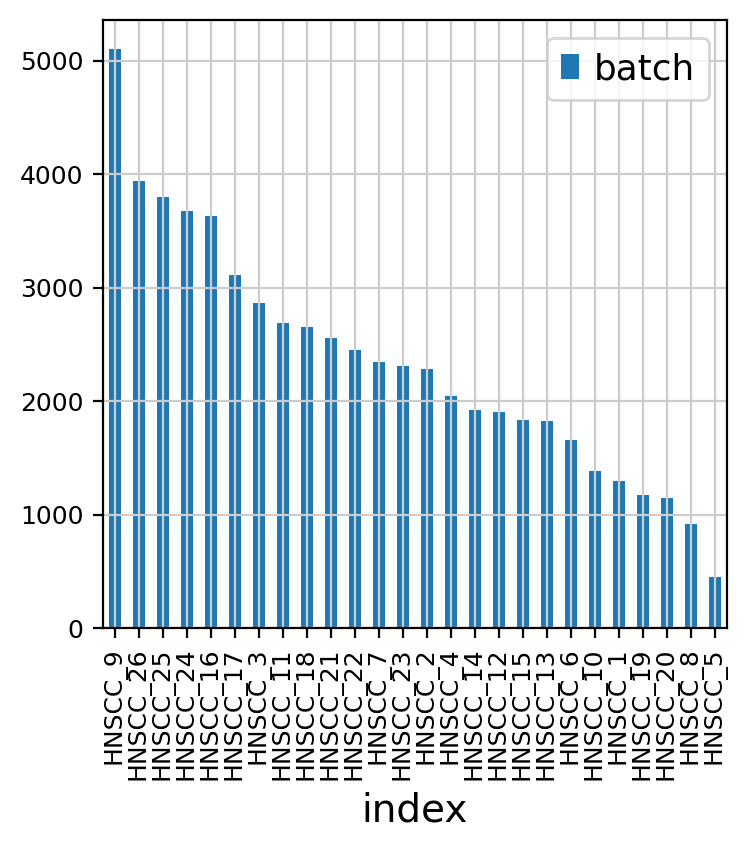

In [104]:
pd.DataFrame(final_adata.obs['batch'].value_counts()).reset_index().plot(
    kind='bar',y='batch',x='index',fontsize=9)

In [111]:
# in average, 2.3k cells loaded for each sample, would be useful to estimate doublets prop
np.mean(final_adata.obs['batch'].value_counts())

2345.230769230769

### Calculate QC

In [107]:
# mitochondrial genes
final_adata.var['mt'] = final_adata.var['genesymbol'].str.startswith('MT-') 
# ribosomal genes
final_adata.var['ribo'] = final_adata.var['genesymbol'].str.startswith(("RPS","RPL"))
# hemoglobin genes.
final_adata.var['hb'] = final_adata.var['genesymbol'].str.contains(("^HB[^(P)]"))

final_adata.var

,genesymbol,mt,ribo,hb
ENSG00000243485,RP11-34P13.3,False,False,False
ENSG00000237613,FAM138A,False,False,False
ENSG00000186092,OR4F5,False,False,False
ENSG00000238009,RP11-34P13.7,False,False,False
ENSG00000239945,RP11-34P13.8,False,False,False
...,...,...,...,...
ENSG00000277856,AC233755.2,False,False,False
ENSG00000275063,AC233755.1,False,False,False
ENSG00000271254,AC240274.1,False,False,False
ENSG00000277475,AC213203.1,False,False,False


In [108]:
sc.pp.calculate_qc_metrics(final_adata, qc_vars=['mt','ribo','hb'], percent_top=None, log1p=False, inplace=True)

In [109]:
final_adata

AnnData object with n_obs × n_vars = 60976 × 33694
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [110]:
mito_genes = final_adata.var['genesymbol'].str.startswith('MT-') 
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
final_adata.obs['percent_mt2'] = np.sum(
    final_adata[:, mito_genes].X, axis=1).A1 / np.sum(final_adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
final_adata.obs['n_counts'] = final_adata.X.sum(axis=1).A1

In [111]:
final_adata.obs

,batch,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,percent_mt2,n_counts
AAACCTGAGCTTTGGT-1-0,GSM4138129_HNSCC_10_TIL_gene,1027,3218.0,112.0,3.480422,1225.0,38.067123,0.0,0.000000,0.034804,3218.0
AAACCTGCAAACCTAC-1-0,GSM4138129_HNSCC_10_TIL_gene,1080,3486.0,122.0,3.499713,1469.0,42.139988,0.0,0.000000,0.034997,3486.0
AAACCTGCACTTCTGC-1-0,GSM4138129_HNSCC_10_TIL_gene,1306,4351.0,85.0,1.953574,1705.0,39.186394,0.0,0.000000,0.019536,4351.0
AAACCTGTCAAGATCC-1-0,GSM4138129_HNSCC_10_TIL_gene,2167,11161.0,521.0,4.668041,2208.0,19.783173,0.0,0.000000,0.046680,11161.0
AAACGGGAGAATTGTG-1-0,GSM4138129_HNSCC_10_TIL_gene,2734,49220.0,515.0,1.046323,2936.0,5.965055,0.0,0.000000,0.010463,49220.0
...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCTACCTGC-1-25,GSM4138131_HNSCC_11_TIL_gene,2408,9411.0,167.0,1.774519,694.0,7.374349,5.0,0.053129,0.017745,9411.0
TTTGGTTTCTTGCATT-1-25,GSM4138131_HNSCC_11_TIL_gene,1444,2769.0,28.0,1.011195,325.0,11.737089,24.0,0.866739,0.010112,2769.0
TTTGTCAAGGTGCACA-1-25,GSM4138131_HNSCC_11_TIL_gene,1221,3013.0,45.0,1.493528,752.0,24.958513,0.0,0.000000,0.014935,3013.0
TTTGTCAGTTAAGATG-1-25,GSM4138131_HNSCC_11_TIL_gene,1200,2879.0,57.0,1.979854,648.0,22.507814,0.0,0.000000,0.019799,2879.0


#### plot some of the QC-features as violin plots.

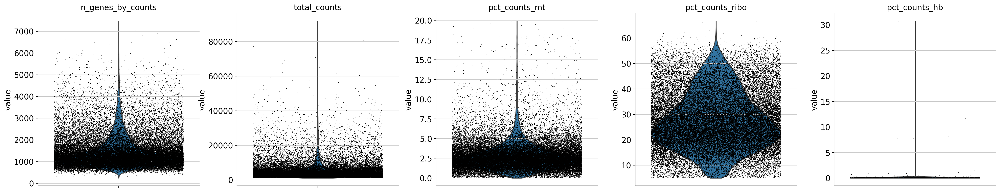

In [128]:
sc.pl.violin(final_adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo', 'pct_counts_hb'],
             jitter=0.4, multi_panel=True, rotation= 45)

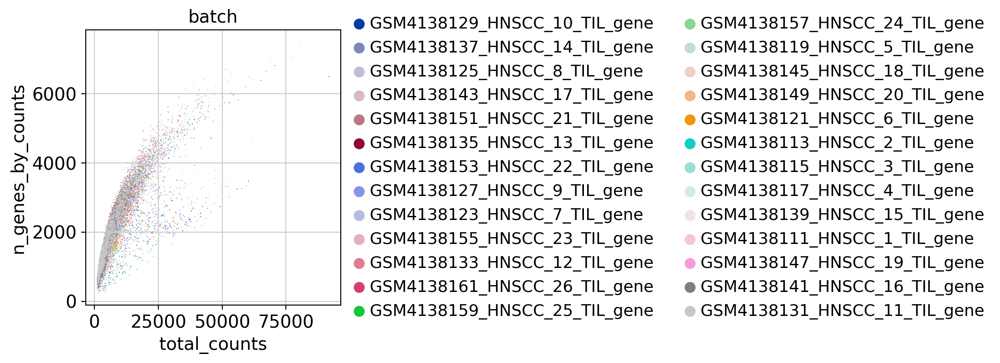

In [126]:
# expect to see an increasing number of detected genes with increasing total count
sc.pl.scatter(final_adata, x='total_counts', y='n_genes_by_counts', color="batch")

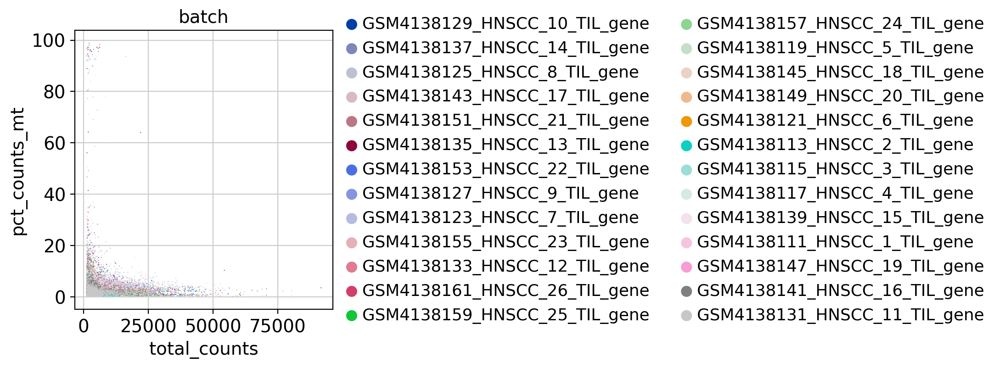

In [117]:
''' 
the total count for each cell against the mitochondrial/ribosomal content. 
Well-behaved cells should have a large number of expressed features and and a low percentage of expression from feature controls. 
High percentage expression from feature controls and few expressed features are indicative of blank and failed cells.
'''
sc.pl.scatter(final_adata, x='total_counts', y='pct_counts_mt', color="batch")

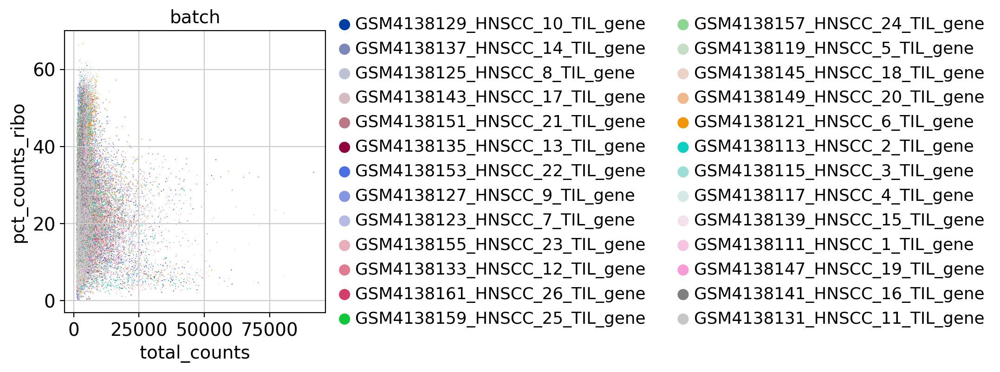

In [118]:
sc.pl.scatter(final_adata, x='total_counts', y='pct_counts_ribo', color="batch")

In [121]:
# Filtering
# begin preprocessing with genes that yield the highest fraction of counts in each single cell, across all cells.
# sc.pl.highest_expr_genes(final_adata, n_top=20)
sc.pp.filter_cells(final_adata, min_genes=200)
sc.pp.filter_genes(final_adata, min_cells=3)
print("cells: ",final_adata.n_obs,",genes: ",final_adata.n_vars)

cells:  60923 ,genes:  23389


normalizing counts per cell
    finished (0:00:01)


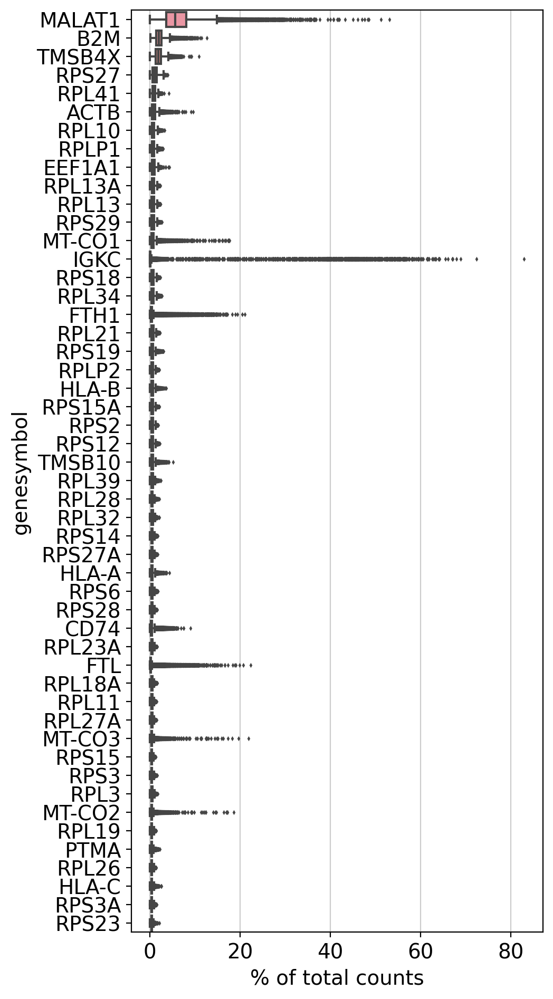

'\nMALAT1 constitutes up to 30% of the UMIs from a single cell and some other top genes are mitochondrial and ribosomal genes. \nIt is quite common that nuclear lincRNAs have correlation with quality and mitochondrial reads, \nso high detection of MALAT1 may be a technical issue\n'

In [120]:
sc.pl.highest_expr_genes(final_adata, n_top=50,gene_symbols='genesymbol')
# We expect to see the “usual suspects”, i.e., mitochondrial genes, actin, ribosomal protein, MALAT1. A few spike-in transcripts may also be present here, 
# though if all of the spike-ins are in the top 50, it suggests that too much spike-in RNA was added. A large number of pseudo-genes or predicted genes may indicate problems with alignment. – Davis McCarthy and Aaron Lun
'''
MALAT1 constitutes up to 30% of the UMIs from a single cell and some other top genes are mitochondrial and ribosomal genes. 
It is quite common that nuclear lincRNAs have correlation with quality and mitochondrial reads, 
so high detection of MALAT1 may be a technical issue
'''

In [122]:
# filter cells for percent mito/ribo
# remove cells with high prop of mito and low prop of ribo reads

final_adata = final_adata[final_adata.obs['pct_counts_mt'] < 20, :]

# filter for percent ribo > 0.05
final_adata = final_adata[final_adata.obs['pct_counts_ribo'] > 5, :]

print("Remaining cells %d"%final_adata.n_obs)

Remaining cells 60173


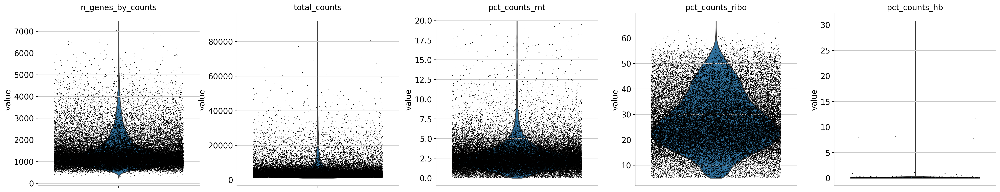

In [123]:
# filtered QC plots
sc.pl.violin(final_adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo', 'pct_counts_hb'],
             jitter=0.4, multi_panel=True, rotation = 45)

In [124]:
final_adata

View of AnnData object with n_obs × n_vars = 60173 × 23389
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors'

In [129]:
# filter genes
# As the level of expression of mitochondrial and MALAT1 genes are judged as mainly technical, 
# it can be wise to remove them from the dataset bofore any further analysis.
malat1 = final_adata.var['genesymbol'].str.startswith('MALAT1')

# we need to redefine the mito_genes since they were first 
# calculated on the full object before removing low expressed genes.
mito_genes = final_adata.var['genesymbol'].str.startswith('MT-') 
hb_genes = final_adata.var['genesymbol'].str.contains('^HB[^(P)]') 
remove = np.add(mito_genes, malat1)
remove = np.add(remove, hb_genes)
keep = np.invert(remove)

final_adata = final_adata[:,keep]

print(final_adata.n_obs, final_adata.n_vars)

60173 23366


In [130]:
'''
Sample Sex
When working with human or animal samples, you should ideally constrain you experiments to a single sex to avoid including sex bias in the conclusions. 
However this may not always be possible. By looking at reads from chromosomeY (males) and XIST (X-inactive specific transcript) expression (mainly female) 
it is quite easy to determine per sample which sex it is. It can also bee a good way to detect if there has been any sample mixups, 
if the sample metadata sex does not agree with the computational predictions.

To get choromosome information for all genes, you should ideally parse the information from the gtf file that you used in the mapping pipeline as it has the exact same annotation version/gene naming. 
However, it may not always be available, as in this case where we have downloaded public data. 
Hence, we will use biomart to fetch chromosome information.

'''
annot = sc.queries.biomart_annotations(
        "hsapiens",
        ["ensembl_gene_id", "external_gene_name", "start_position", "end_position", "chromosome_name"],
    ).set_index("ensembl_gene_id")
#>>> adata.var[annot.columns] = annot

In [131]:
annot.index[annot.chromosome_name == "Y"]

Index(['ENSG00000215601', 'ENSG00000215603', 'ENSG00000231341',
       'ENSG00000231436', 'ENSG00000234795', 'ENSG00000225878',
       'ENSG00000236435', 'ENSG00000278478', 'ENSG00000258991',
       'ENSG00000237048',
       ...
       'ENSG00000242875', 'ENSG00000234414', 'ENSG00000228257',
       'ENSG00000184991', 'ENSG00000271123', 'ENSG00000226042',
       'ENSG00000237023', 'ENSG00000229416', 'ENSG00000230029',
       'ENSG00000223637'],
      dtype='object', name='ensembl_gene_id', length=525)

In [132]:
# Now that we have the chromosome information, we can calculate per cell the proportion of reads that comes from chromosome Y.
chrY_genes = final_adata.var_names.intersection(annot.index[annot.chromosome_name == "Y"])
chrY_genes

Index(['ENSG00000129824', 'ENSG00000278847', 'ENSG00000067646',
       'ENSG00000233070', 'ENSG00000231535', 'ENSG00000229308',
       'ENSG00000099715', 'ENSG00000114374', 'ENSG00000067048',
       'ENSG00000183878', 'ENSG00000154620', 'ENSG00000165246',
       'ENSG00000230663', 'ENSG00000233522', 'ENSG00000176728',
       'ENSG00000260197', 'ENSG00000012817', 'ENSG00000229236',
       'ENSG00000198692', 'ENSG00000280969', 'ENSG00000228786'],
      dtype='object')

In [133]:
final_adata.obs['percent_chrY'] = np.sum(
    final_adata[:, chrY_genes].X, axis=1).A1 / np.sum(final_adata.X, axis=1).A1 * 100

/tmp/ipykernel_6354/837310232.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  final_adata.obs['percent_chrY'] = np.sum(


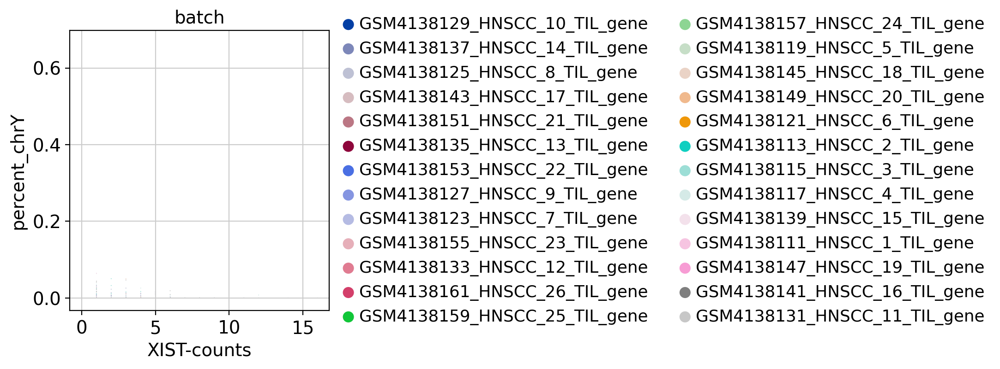

In [134]:
# Then plot XIST expression vs chrY proportion. 
# As you can see, the samples are clearly on either side, even if some cells do not have detection of either.
# color inputs must be from either .obs or .var, so add in XIST expression to obs.
final_adata.obs["XIST-counts"] = final_adata.X[:,final_adata.var['genesymbol'].str.match('XIST')].toarray()

sc.pl.scatter(final_adata, x='XIST-counts', y='percent_chrY', color="batch")

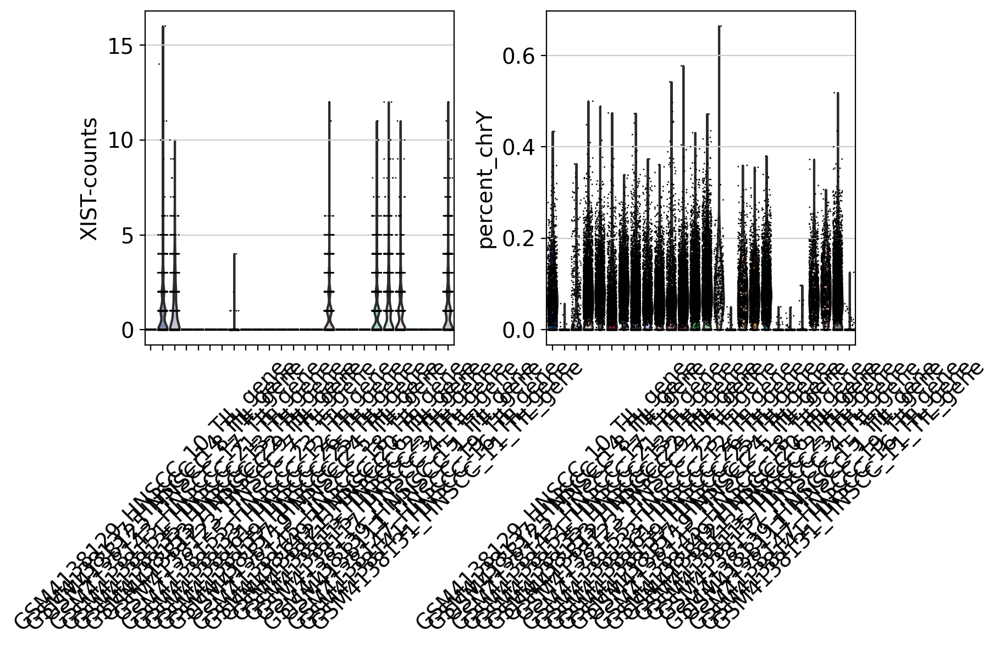

In [135]:
# several male and females are identifiable 
sc.pl.violin(final_adata, ["XIST-counts", "percent_chrY"], jitter=0.4, groupby = 'batch', rotation= 45)

In [ ]:
# currently no effect for sex sampling

In [136]:
# save normalized counts in raw slot.
final_adata.raw = final_adata

# normalize to depth 10 000
sc.pp.normalize_per_cell(final_adata, counts_per_cell_after=1e4)

# logaritmize
sc.pp.log1p(final_adata)

normalizing by total count per cell
    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.44
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 1.0%
	Estimated  = 0.6%
Elapsed time: 147.4 seconds


2

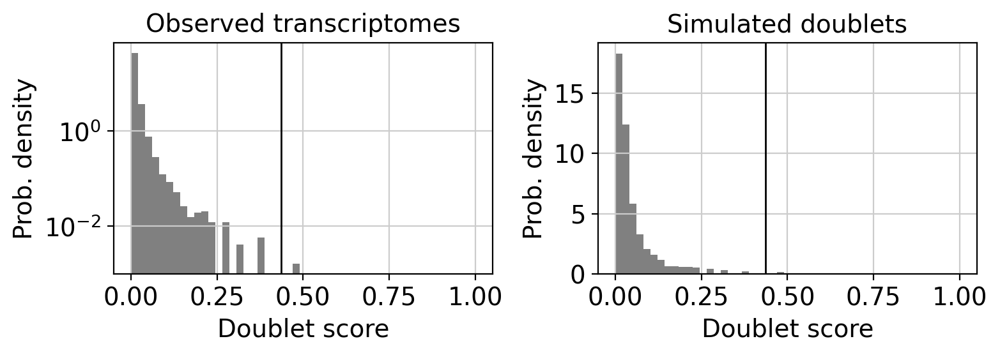

In [137]:
# Predict doublets
'''
Doublets/Mulitples of cells in the same well/droplet is a common issue in scRNAseq protocols. Especially in droplet-based methods whith overloading of cells. 
In a typical 10x experiment the proportion of doublets is linearly dependent on the amount of loaded cells. 
Most doublet detectors simulates doublets by merging cell counts and predicts doublets as cells that have similar embeddings as the simulated doublets.
Most such packages need an assumption about the number/proportion of expected doublets in the dataset.
Data Cillo has an average 2k cells loaded among all samples, so it should have a doublet rate at ~1%
'''
import scrublet as scr
scrub = scr.Scrublet(final_adata.raw.X,expected_doublet_rate=0.01)
final_adata.obs['doublet_scores'], final_adata.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

sum(final_adata.obs['predicted_doublets'])

In [139]:
# 2 doublets identified.
final_adata.obs[final_adata.obs['predicted_doublets']==True]

,batch,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,percent_mt2,n_counts,n_genes,percent_chrY,XIST-counts,doublet_scores,predicted_doublets
GCATGTAGTTGGTAAA-1-7,GSM4138127_HNSCC_9_TIL_gene,1653,4840.0,104.0,2.148760,1589.0,32.830578,1.0,0.020661,0.021488,4491.0,1653,0.089067,0.0,0.482353,True
AACTCCCGTCATATCG-1-22,GSM4138111_HNSCC_1_TIL_gene,1408,4335.0,205.0,4.728951,1583.0,36.516724,0.0,0.000000,0.047290,3854.0,1408,0.103788,0.0,0.482353,True


In [ ]:
'''
The simulated doublet histogram is typically bimodal. 
The left mode corresponds to "embedded" doublets generated by two cells with similar gene expression. 
The right mode corresponds to "neotypic" doublets, which are generated by cells with distinct gene expression (e.g., different cell types) 
and are expected to introduce more artifacts in downstream analyses. Scrublet can only detect neotypic doublets.
'''

In [140]:
# add in column with singlet/doublet instead of True/False
final_adata.obs['doublet_info'] = final_adata.obs["predicted_doublets"].astype(str)

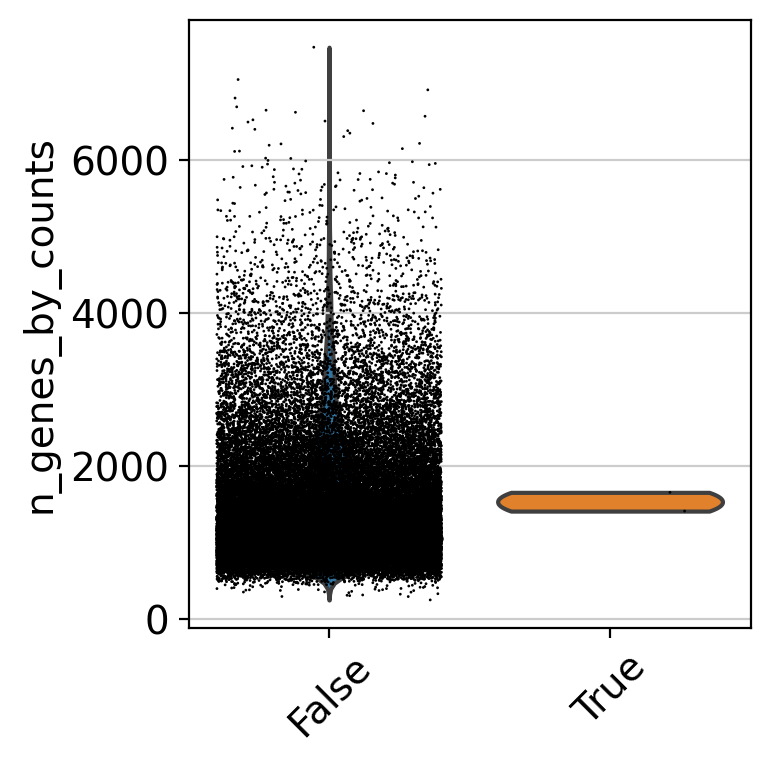

In [141]:
# We should expect that two cells have more detected genes than a single cell, 
# lets check if our predicted doublets also have more detected genes in general.
sc.pl.violin(final_adata, 'n_genes_by_counts',
             jitter=0.4, groupby = 'doublet_info', rotation=45)

In [142]:
# Now, lets run PCA and UMAP and plot doublet scores onto umap to check the doublet predictions.
sc.pp.highly_variable_genes(final_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
final_adata = final_adata[:, final_adata.var.highly_variable]
sc.pp.regress_out(final_adata, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(final_adata, max_value=10)
sc.tl.pca(final_adata, svd_solver='arpack')
sc.pp.neighbors(final_adata, n_neighbors=10, n_pcs=40)
sc.tl.umap(final_adata)

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:01:35)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:05)


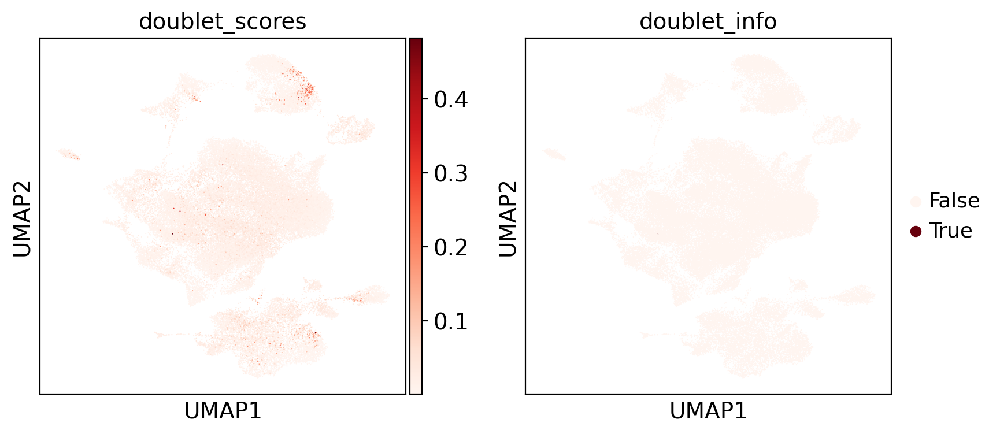

In [143]:
# very little amount of doublets are found, hardly recognizable from plots
sc.pl.umap(final_adata, color=['doublet_scores','doublet_info'],color_map='Reds',palette='Reds')

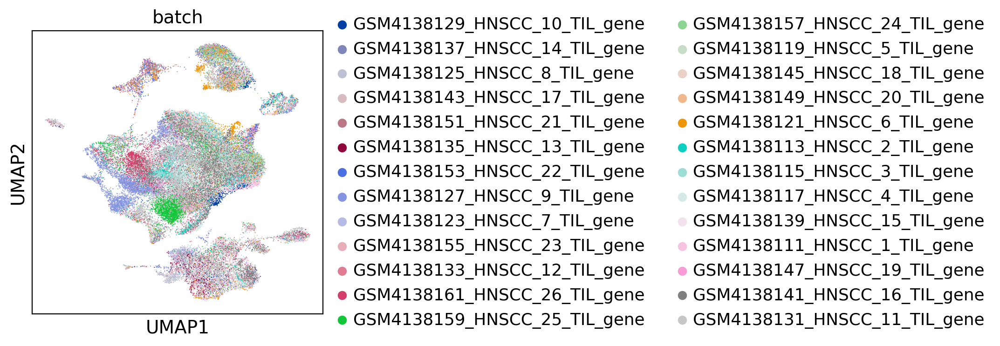

In [144]:
sc.pl.umap(final_adata, color=['batch'])

In [145]:
# remove all doublets predicted from data
# also revert back to the raw counts as the main matrix in adata
final_adata = final_adata.raw.to_adata() 

final_adata = final_adata[final_adata.obs['doublet_info'] == 'False',:]
print(final_adata.shape)

(60171, 23366)


In [147]:
final_adata

View of AnnData object with n_obs × n_vars = 60171 × 23366
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'log1p', 'doublet_info_colors', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [146]:
final_adata.write(results_file)

In [151]:
final_adata = sc.read_h5ad(results_file)
final_adata.uns['log1p']["base"] = None
final_adata

AnnData object with n_obs × n_vars = 60171 × 23366
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [153]:
final_adata.obs

,batch,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,percent_mt2,n_counts,n_genes,percent_chrY,XIST-counts,doublet_scores,predicted_doublets,doublet_info
AAACCTGAGCTTTGGT-1-0,GSM4138129_HNSCC_10_TIL_gene,1027,3218.0,112.0,3.480422,1225.0,38.067123,0.0,0.000000,0.034804,2903.0,1027,0.034447,0.0,0.005625,False,False
AAACCTGCAAACCTAC-1-0,GSM4138129_HNSCC_10_TIL_gene,1080,3486.0,122.0,3.499713,1469.0,42.139988,0.0,0.000000,0.034997,3107.0,1080,0.000000,0.0,0.008171,False,False
AAACCTGCACTTCTGC-1-0,GSM4138129_HNSCC_10_TIL_gene,1306,4351.0,85.0,1.953574,1705.0,39.186394,0.0,0.000000,0.019536,4088.0,1306,0.048924,0.0,0.020201,False,False
AAACCTGTCAAGATCC-1-0,GSM4138129_HNSCC_10_TIL_gene,2167,11161.0,521.0,4.668041,2208.0,19.783173,0.0,0.000000,0.046680,9666.0,2167,0.020691,0.0,0.004840,False,False
AAACGGGAGAATTGTG-1-0,GSM4138129_HNSCC_10_TIL_gene,2734,49220.0,515.0,1.046323,2936.0,5.965055,0.0,0.000000,0.010463,48321.0,2734,0.012417,0.0,0.008854,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCTACCTGC-1-25,GSM4138131_HNSCC_11_TIL_gene,2408,9411.0,167.0,1.774519,694.0,7.374349,5.0,0.053129,0.017745,8941.0,2408,0.000000,0.0,0.004840,False,False
TTTGGTTTCTTGCATT-1-25,GSM4138131_HNSCC_11_TIL_gene,1444,2769.0,28.0,1.011195,325.0,11.737089,24.0,0.866739,0.010112,2509.0,1444,0.000000,2.0,0.000841,False,False
TTTGTCAAGGTGCACA-1-25,GSM4138131_HNSCC_11_TIL_gene,1221,3013.0,45.0,1.493528,752.0,24.958513,0.0,0.000000,0.014935,2801.0,1221,0.000000,0.0,0.023224,False,False
TTTGTCAGTTAAGATG-1-25,GSM4138131_HNSCC_11_TIL_gene,1200,2879.0,57.0,1.979854,648.0,22.507814,0.0,0.000000,0.019799,2717.0,1200,0.000000,1.0,0.015982,False,False


In [154]:
df_annotation = pd.read_csv("/home/cke/Cilio/cillo_immunity_fitsne_cell_annotations_220622.csv.gz")
df_annotation

,cell_barcodes,FItSNE_1,FItSNE_2,cell_type_annotations
0,AAACCTGCACAGACTT,-0.088718,-3.949469,cd8.cells
1,AAACCTGCATCGGTTA,7.162101,-25.850694,cd14.cells
2,AAACCTGTCAAGCCTA,1.154112,-4.324750,cd8.cells
3,AAACCTGTCTTAACCT,2.083668,-12.106379,cd8.cells
4,AAACGGGCAATAGCGG,0.880007,-2.571512,cd8.cells
...,...,...,...,...
131219,TILp,25.536454,6.505171,cd8.cells
131220,TILp,18.480221,46.980300,mast.cells
131221,TILp,32.800583,29.582970,cd8.cells
131222,TILp,45.879116,13.091147,pdc.cells


In [181]:
df_annotation['cell_barcodes'].value_counts()

TILp                59596
PBL                 46809
CTCGGGACAAGCTGTT        3
GGACAGACAAATTGCC        3
CATCGGGAGTACGTAA        3
                    ...  
GTATTCTTCGTTTAGG        1
GTATTCTGTATGGTTC        1
GTATTCTCATCATCCC        1
GTATTCTAGAAGAAGC        1
AAGGCAGGTAACGTTC        1
Name: cell_barcodes, Length: 24460, dtype: int64

In [182]:
df_annotation[df_annotation['cell_barcodes']=="AAACCTGAGGCAAAGA"]

,cell_barcodes,FItSNE_1,FItSNE_2,cell_type_annotations
22479,AAACCTGAGGCAAAGA,45.594542,-11.542082,b.cells


In [155]:
df_obs = final_adata.obs

In [157]:
df_obs['cell_barcodes'] = df_obs.index.tolist()

In [161]:
df_obs['cell_barcodes'] = df_obs['cell_barcodes'].str.split("-",expand=True)[0]

In [172]:
df_obs['cell_barcodes'].value_counts()

GCTGCTTAGACTGGGT    3
GCATGTAAGTTAAGTG    3
TCGCGAGAGTGAACAT    3
CTCGGGACAGAAGCAC    3
AAACCTGTCTGATTCT    3
                   ..
GAATGAACACTGCCAG    1
GAATGAAGTAGATTAG    1
GAATGAAGTTAAAGAC    1
GACACGCAGTACACCT    1
TTTGTCATCAGTGCAT    1
Name: cell_barcodes, Length: 57854, dtype: int64

In [ ]:
pd.merge(final_adata.obs,df_annotation,)

## 2. Dim reduction

In [183]:
# Before variable gene selection we need to normalize and logaritmize the data. 
# Then store the full matrix in the raw slot before doing variable gene selection.
# normalize to depth 10 000
cillo_adata = final_adata 
# To make sure result retractable, cillo_adata will be our subject from here on
sc.pp.normalize_per_cell(cillo_adata, counts_per_cell_after=1e4)

# logaritmize
sc.pp.log1p(cillo_adata)

# store normalized counts in the raw slot, 
# we will subset final_adata.X for variable genes, but want to keep all genes matrix as well.
cillo_adata.raw = cillo_adata

cillo_adata

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


AnnData object with n_obs × n_vars = 60171 × 23366
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cell_barcodes'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 1288


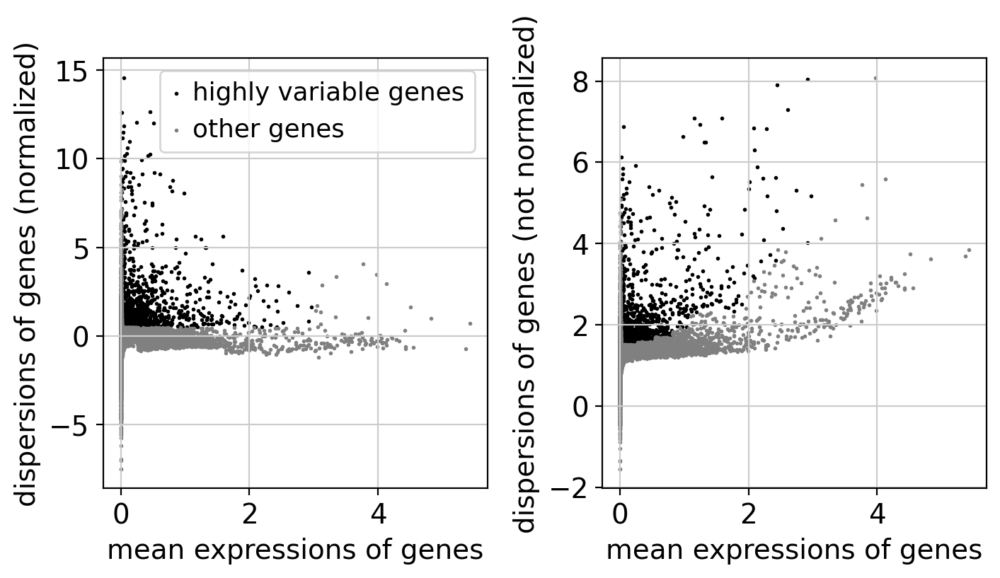

In [184]:
# Next, we first need to define which features/genes are important in our dataset to distinguish cell types. 
# For this purpose, we need to find genes that are highly variable across cells, which in turn will also provide a good separation of the cell clusters.
# compute variable genes
sc.pp.highly_variable_genes(cillo_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
print("Highly variable genes: %d"%sum(cillo_adata.var.highly_variable))

#plot variable genes
sc.pl.highly_variable_genes(cillo_adata)

# subset for variable genes in the dataset
cillo_adata = cillo_adata[:, cillo_adata.var['highly_variable']]

Now that the data is prepared, we now proceed with PCA. Since each gene has a different expression level, it means that genes with higher expression values will naturally have higher variation that will be captured by PCA. This means that we need to somehow give each gene a similar weight when performing PCA (see below). The common practice is to center and scale each gene before performing PCA. This exact scaling is called Z-score normalization it is very useful for PCA, clustering and plotting heatmaps.

Additionally, we can use regression to remove any unwanted sources of variation from the dataset, such as cell cycle, sequencing depth, percent mitocondria. This is achieved by doing a generalized linear regression using these parameters as covariates in the model. Then the residuals of the model are taken as the "regressed data". Although perhaps not in the best way, batch effect regression can also be done here.

In [185]:
# cillo_adata = cillo_adata.copy()     #run this line if you get the "AttributeError: swapaxes not found" 

# regress out unwanted variables
sc.pp.regress_out(cillo_adata, ['total_counts', 'pct_counts_mt'])

# scale data, clip values exceeding standard deviation 10.
sc.pp.scale(cillo_adata, max_value=10)

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


    finished (0:01:35)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:08)


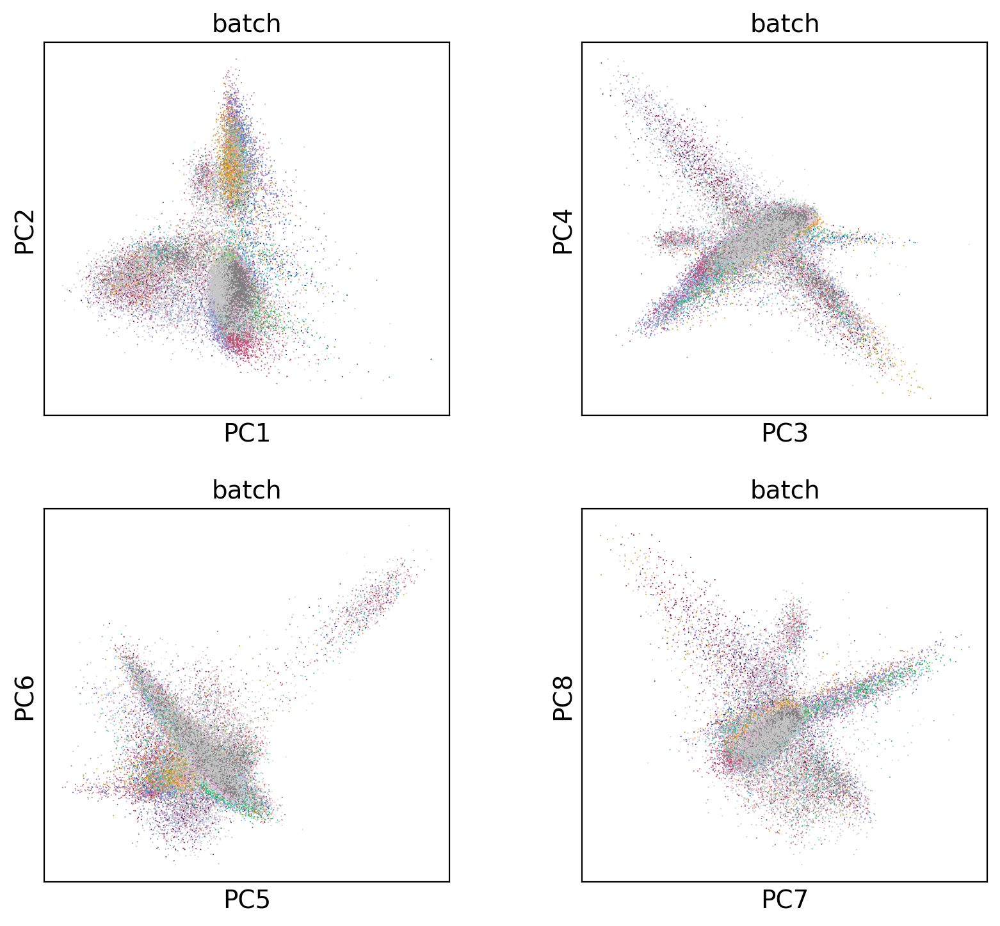

In [188]:
# PCA
# Performing PCA has many useful applications and interpretations, 
# which much depends on the data used. In the case of life sciences, 
# we want to segregate samples based on gene expression patterns in the data.
sc.tl.pca(cillo_adata, svd_solver='arpack')

# plot more PCS
sc.pl.pca(cillo_adata, color='batch', components = ['1,2','3,4','5,6','7,8'], ncols=2, legend_loc = None)

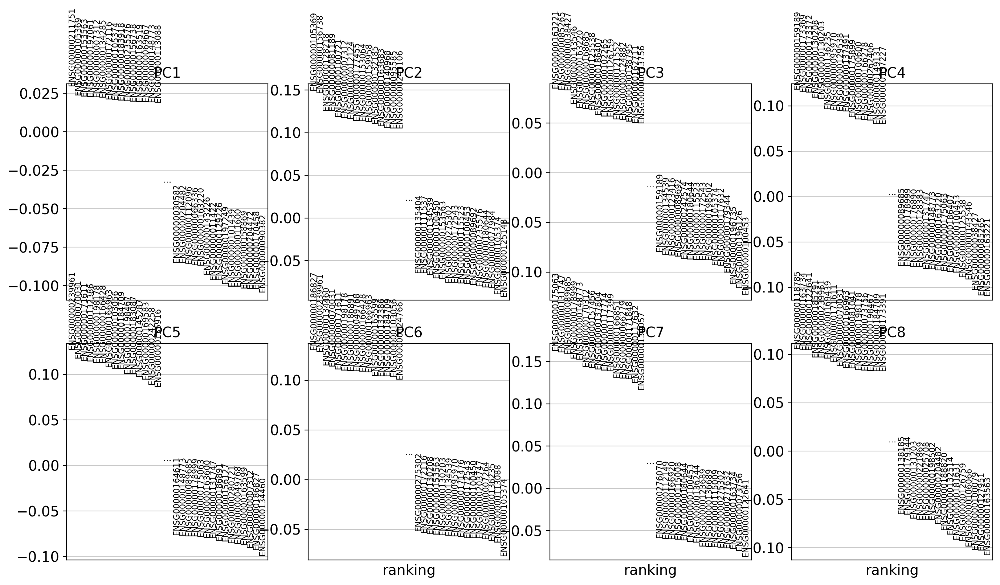

In [189]:
#Plot loadings
sc.pl.pca_loadings(cillo_adata, components=[1,2,3,4,5,6,7,8])

# OBS! only plots the positive axes genes from each PC!!

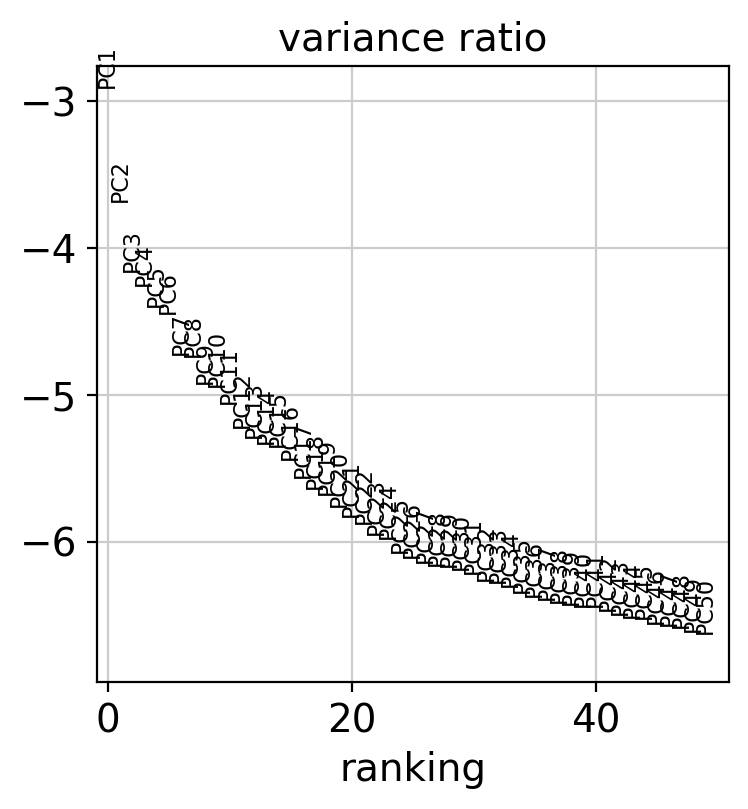

In [190]:
sc.pl.pca_variance_ratio(cillo_adata, log=True, n_pcs = 50)

Based on this plot, we can see that the top 8 PCs retain a lot of information, while other PCs contain pregressivelly less. However, it is still advisable to use more PCs since they might contain informaktion about rare cell types (such as platelets and DCs in this dataset)



In [191]:
# regular BH T-SNE plot
sc.tl.tsne(cillo_adata, n_pcs = 30)

computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:03:51)


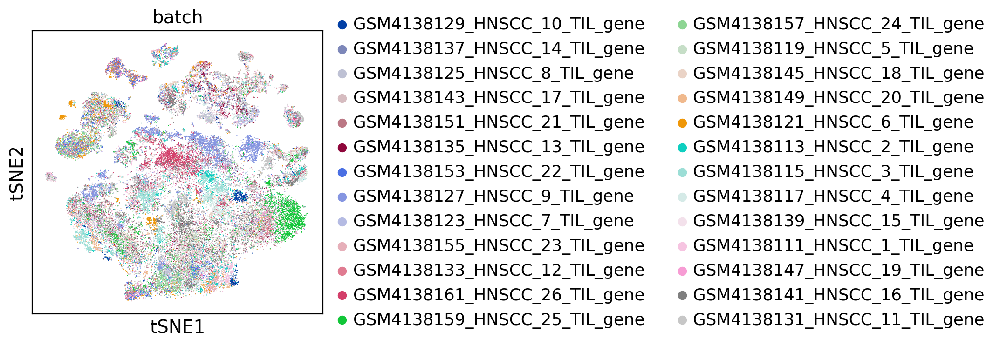

In [192]:
sc.pl.tsne(cillo_adata, color='batch')
# We can clearly see the effect of batches present in the dataset.

In [193]:
sc.pp.neighbors(cillo_adata, n_pcs = 30, n_neighbors = 20)

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)


In [194]:
sc.tl.umap(cillo_adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:25)


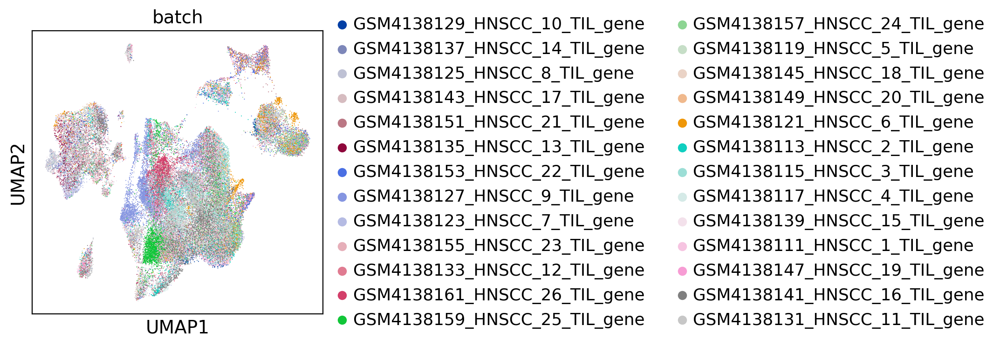

In [195]:
sc.pl.umap(cillo_adata, color='batch')

In [196]:
cillo_adata

AnnData object with n_obs × n_vars = 60171 × 1288
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cell_barcodes'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'tsne'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [197]:
print(cillo_adata.X.shape)
print(cillo_adata.raw.X.shape)

(60171, 1288)
(60171, 23366)


In [7]:
cillo_adata = sc.read_h5ad(results_file)
cillo_adata.uns['log1p']["base"] = None
cillo_adata

AnnData object with n_obs × n_vars = 131780 × 1464
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'louvain', 'louvain_0.4_colors', 'louvain_0.6_colors', 'louvain_1.0_colors', 'louvain_1.4_colors', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [198]:
save_file = './Cilio/scanpy_qc_dr_Cillo.h5ad'
cillo_adata.write_h5ad(save_file)

## Data integration
As the stored AnnData object contains scaled data based on variable genes, we need to make a new object with the logtransformed normalized counts. The new variable gene selection should not be performed on the scaled data matrix.



In [199]:
adata2 = cillo_adata.raw.to_adata() 

# check that the matrix looks like noramlized counts
print(adata2.X[1:10,1:10])

  (2, 2)	0.71027666
  (7, 1)	2.0345666


In [200]:
var_genes_all = cillo_adata.var.highly_variable

print("Highly variable genes: %d"%sum(var_genes_all))

Highly variable genes: 1288


In [201]:
# Detect variable genes in each dataset separately using the batch_key parameter.

sc.pp.highly_variable_genes(adata2, min_mean=0.0125, max_mean=3, min_disp=0.5, batch_key = 'batch')

print("Highly variable genes intersection: %d"%sum(adata2.var.highly_variable_intersection))

print("Number of batches where gene is variable:")
print(adata2.var.highly_variable_nbatches.value_counts())

var_genes_batch = adata2.var.highly_variable_nbatches > 0

extracting highly variable genes


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:4

    finished (0:00:13)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes intersection: 109
Number of batches where gene is variable:
0     11288
1      3022
2      2002
3      1503
4      1147
5       919
6       676
7       503
8       383
9       304
10      220
11      187
12      128
13      127
26      109
14      104
15       91
17       81
25       80
16       74
18       69
21       65
24       64
23       58
20       56
22       56
19       50
Name: highly_variable_nbatches, dtype: int64


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)


In [205]:
print("Any batch var genes: %d"%sum(var_genes_batch))
print("All data var genes: %d"%sum(var_genes_all))
print("Overlap: %d"%sum(var_genes_batch & var_genes_all))
print("Variable genes in all batches: %d"%sum(adata2.var.highly_variable_nbatches == 6))
print("Overlap batch instersection and all: %d"%sum(var_genes_all & adata2.var.highly_variable_intersection))

Any batch var genes: 12078
All data var genes: 1288
Overlap: 1286
Variable genes in all batches: 676
Overlap batch instersection and all: 109


In [206]:
# Select all genes that are variable in at least 2 datasets and use for remaining analysis.
var_select = adata2.var.highly_variable_nbatches > 2
var_genes = var_select.index[var_select]
len(var_genes)

7054

In [207]:
# Data integration
# split per batch into new objects.
batches = cillo_adata.obs['batch'].cat.categories.tolist()
alldata = {}
for batch in batches:
    alldata[batch] = adata2[adata2.obs['batch'] == batch,]
alldata   

{'GSM4138129_HNSCC_10_TIL_gene': View of AnnData object with n_obs × n_vars = 1357 × 23366
     obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cell_barcodes'
     var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
     uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'tsne'
     obsm: 'X_pca', 'X_umap', 'X_tsne'
     obsp: 'connectivities', 'distances',
 'GSM4138137_HNSCC_14_TIL_gene': View of AnnData object with n_obs × n_vars = 1868 × 23366
     obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',

In [208]:
import scanorama

In [236]:
# MNN too cumbersome, try combat, scanorama, harmony, and bbknn instead

#### COMBAT

In [15]:
# create a new object with lognormalized counts
adata_combat = sc.AnnData(X=cillo_adata.raw.X, var=cillo_adata.raw.var, obs = cillo_adata.obs)

# first store the raw data 
adata_combat.raw = adata_combat

# run combat
sc.pp.combat(adata_combat, key='batch')

Standardizing Data across genes.

Found 63 batches

Found 0 numerical variables:
	

Found 2 genes with zero variance.
Fitting L/S model and finding priors

Finding parametric adjustments



/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_combat.py:340: RuntimeWarning: invalid value encountered in true_divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()
/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/scanpy/preprocessing/_combat.py:340: RuntimeWarning: divide by zero encountered in true_divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


Adjusting data



extracting highly variable genes
    finished (0:01:16)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 3100


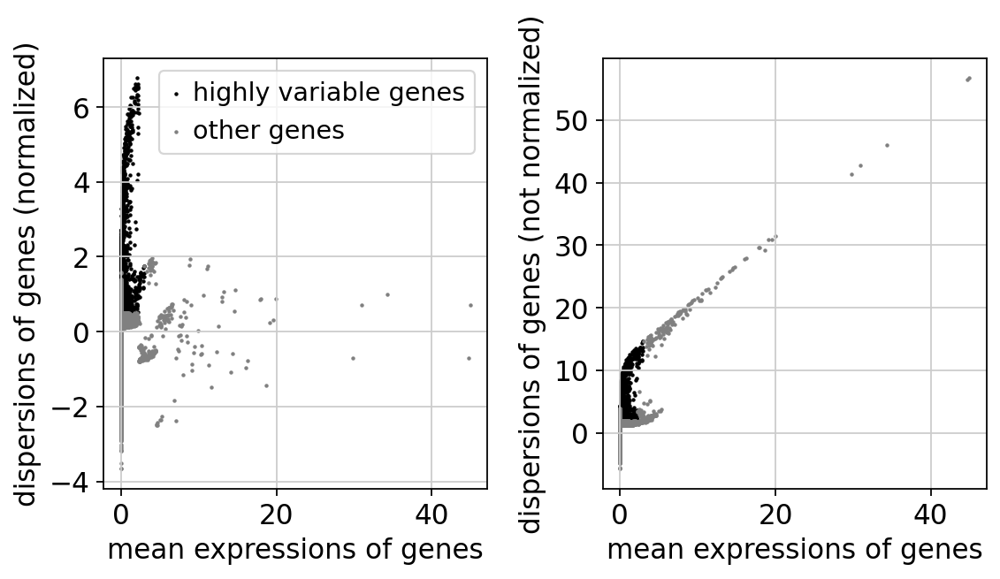

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:57)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:53)
computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:12:13)


In [16]:
sc.pp.highly_variable_genes(adata_combat)
print("Highly variable genes: %d"%sum(adata_combat.var.highly_variable))
sc.pl.highly_variable_genes(adata_combat)


sc.pp.pca(adata_combat, n_comps=30, use_highly_variable=True, svd_solver='arpack')

sc.pp.neighbors(adata_combat, n_pcs =30)

sc.tl.umap(adata_combat)
sc.tl.tsne(adata_combat, n_pcs = 30)

In [17]:
# compare var_genes
var_genes_combat = adata_combat.var.highly_variable
print("With all data %d"%sum(var_genes_all))
print("With combat %d"%sum(var_genes_combat))
print("Overlap %d"%sum(var_genes_all & var_genes_combat))

print("With 2 batches %d"%sum(var_select))
print("Overlap %d"%sum(var_genes_combat & var_select))

With all data 1464
With combat 3100
Overlap 1088
With 2 batches 12396
Overlap 3004


<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

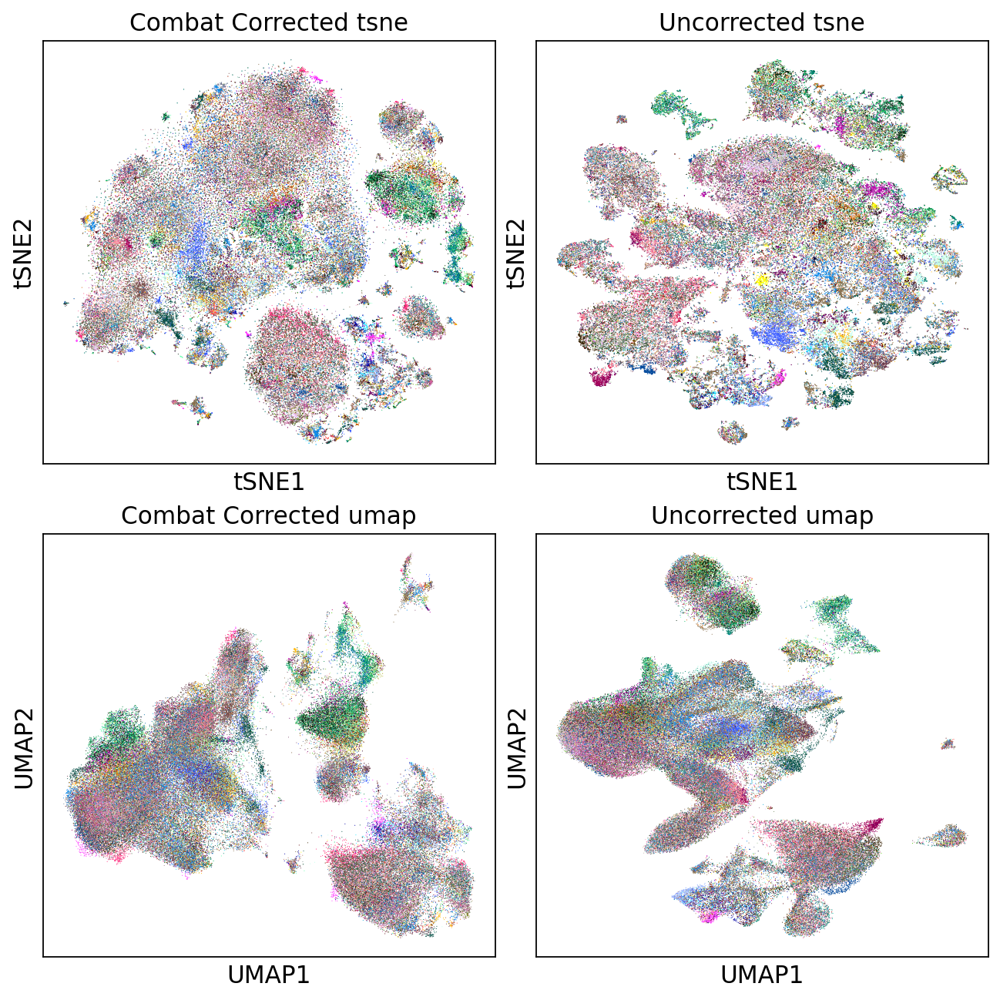

In [30]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_combat, color="batch", title="Combat Corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="batch", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_combat, color="batch", title="Combat Corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="batch", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

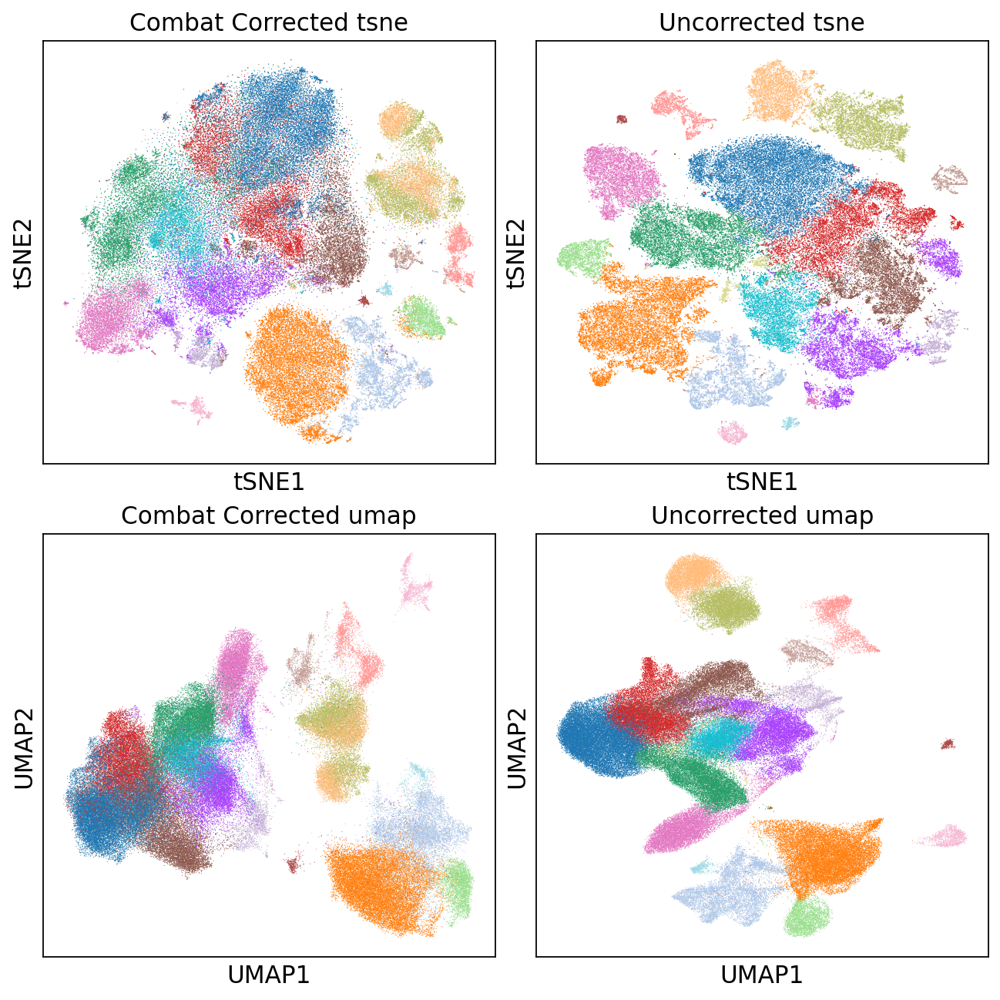

In [57]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_combat, color="louvain_0.6", title="Combat Corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="louvain_0.6", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_combat, color="louvain_0.6", title="Combat Corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="louvain_0.6", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [ ]:
adata_combat = sc.read_h5ad(save_file)
adata_combat.uns['log1p']["base"] = None
adata_combat

In [24]:
#save to file
save_file = './Cilio/scanpy_combat_corrected_Cillo.h5ad'
adata_combat.write_h5ad(save_file)

#### Scanorama

In [32]:
#subset the individual dataset to the same variable genes as in MNN-correct.
alldata2 = dict()
for ds in alldata.keys():
    print(ds)
    alldata2[ds] = alldata[ds][:,var_genes]

#convert to list of AnnData objects
adatas = list(alldata2.values())

# run scanorama.integrate
scanorama.integrate_scanpy(adatas, dimred = 50)

GSM4138129_HNSCC_10_TIL_gene
GSM4138137_HNSCC_14_TIL_gene
GSM4138125_HNSCC_8_TIL_gene
GSM4138143_HNSCC_17_TIL_gene
GSM4138169_HD_2_Tonsil_gene
GSM4138151_HNSCC_21_TIL_gene
GSM4138116_HNSCC_4_PBMC_gene
GSM4138118_HNSCC_5_PBMC_gene
GSM4138130_HNSCC_11_PBMC_gene
GSM4138135_HNSCC_13_TIL_gene
GSM4138153_HNSCC_22_TIL_gene
GSM4138150_HNSCC_21_PBMC_gene
GSM4138127_HNSCC_9_TIL_gene
GSM4138123_HNSCC_7_TIL_gene
GSM4138154_HNSCC_23_PBMC_gene
GSM4138155_HNSCC_23_TIL_gene
GSM4138133_HNSCC_12_TIL_gene
GSM4138161_HNSCC_26_TIL_gene
GSM4138163_HD_2_PBMC_gene
GSM4138112_HNSCC_2_PBMC_gene
GSM4138159_HNSCC_25_TIL_gene
GSM4138114_HNSCC_3_PBMC_gene
GSM4138134_HNSCC_13_PBMC_gene
GSM4138144_HNSCC_18_PBMC_gene
GSM4138140_HNSCC_16_PBMC_gene
GSM4138148_HNSCC_20_PBMC_gene
GSM4138122_HNSCC_7_PBMC_gene
GSM4138142_HNSCC_17_PBMC_gene
GSM4138132_HNSCC_12_PBMC_gene
GSM4138168_HD_1_Tonsil_gene
GSM4138157_HNSCC_24_TIL_gene
GSM4138166_HD_5_PBMC_gene
GSM4138119_HNSCC_5_TIL_gene
GSM4138158_HNSCC_25_PBMC_gene
GSM4138145_HNSCC

KeyboardInterrupt: 

In [ ]:
#scanorama adds the corrected matrix to adata.obsm in each of the datasets in adatas.
adatas[0].obsm['X_scanorama'].shape

In [ ]:
adata_scanorama = sc.AnnData(X=cillo_adata.raw.X, var=cillo_adata.raw.var, obs = cillo_adata.obs)
adata_scanorama.raw = adata_scanorama

In [ ]:
# Get all the integrated matrices.
scanorama_int = [ad.obsm['X_scanorama'] for ad in adatas]

# make into one matrix.
all_s = np.concatenate(scanorama_int)
print(all_s.shape)

# add to the AnnData object
adata_scanorama.obsm["Scanorama"] = all_s

In [242]:
# tsne and umap
sc.pp.neighbors(adata_scanorama, n_pcs =50, use_rep = "Scanorama")
sc.tl.umap(adata_scanorama)
sc.tl.tsne(adata_scanorama, n_pcs = 50, use_rep = "Scanorama")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:15)
computing tSNE
    using sklearn.manifold.TSNE


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:14:34)


<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

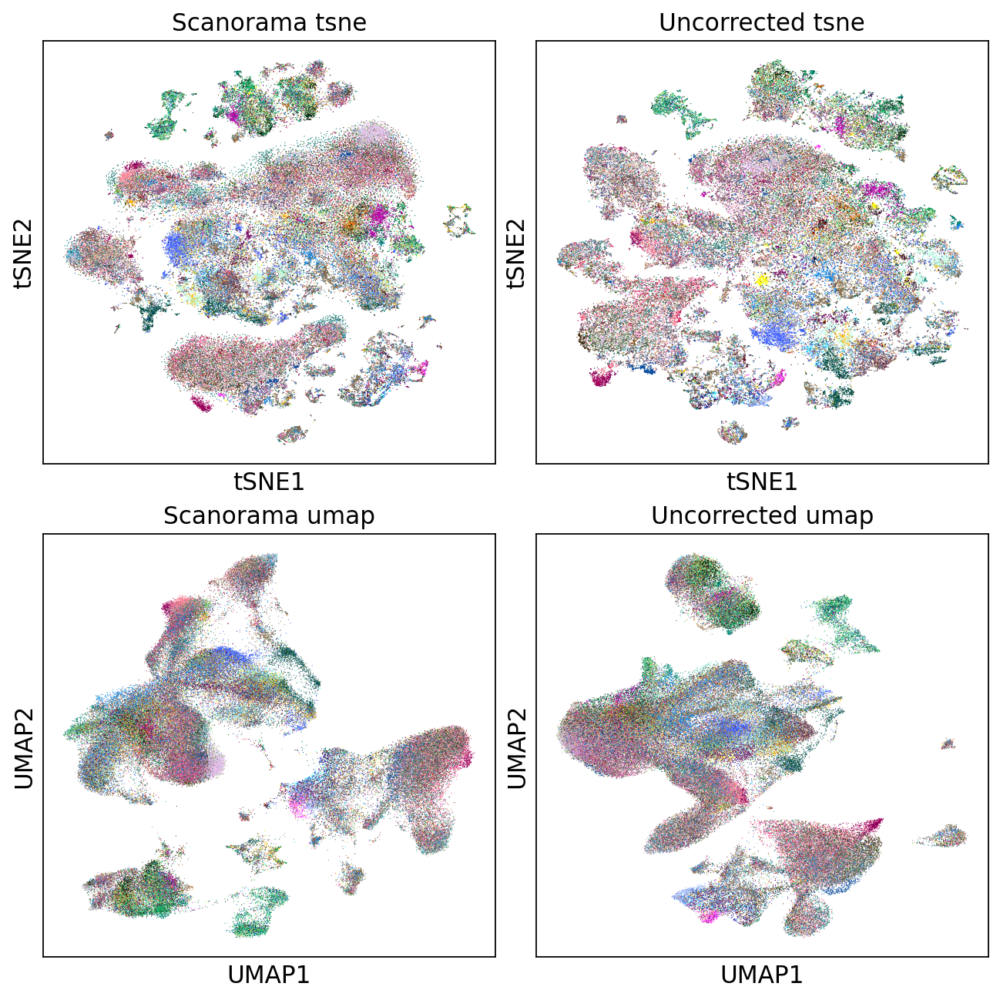

In [39]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_scanorama, color="batch", title="Scanorama tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="batch", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_scanorama, color="batch", title="Scanorama umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="batch", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [54]:
adata_scanorama

AnnData object with n_obs × n_vars = 131780 × 24677
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'tsne', 'umap'
    obsm: 'Scanorama', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

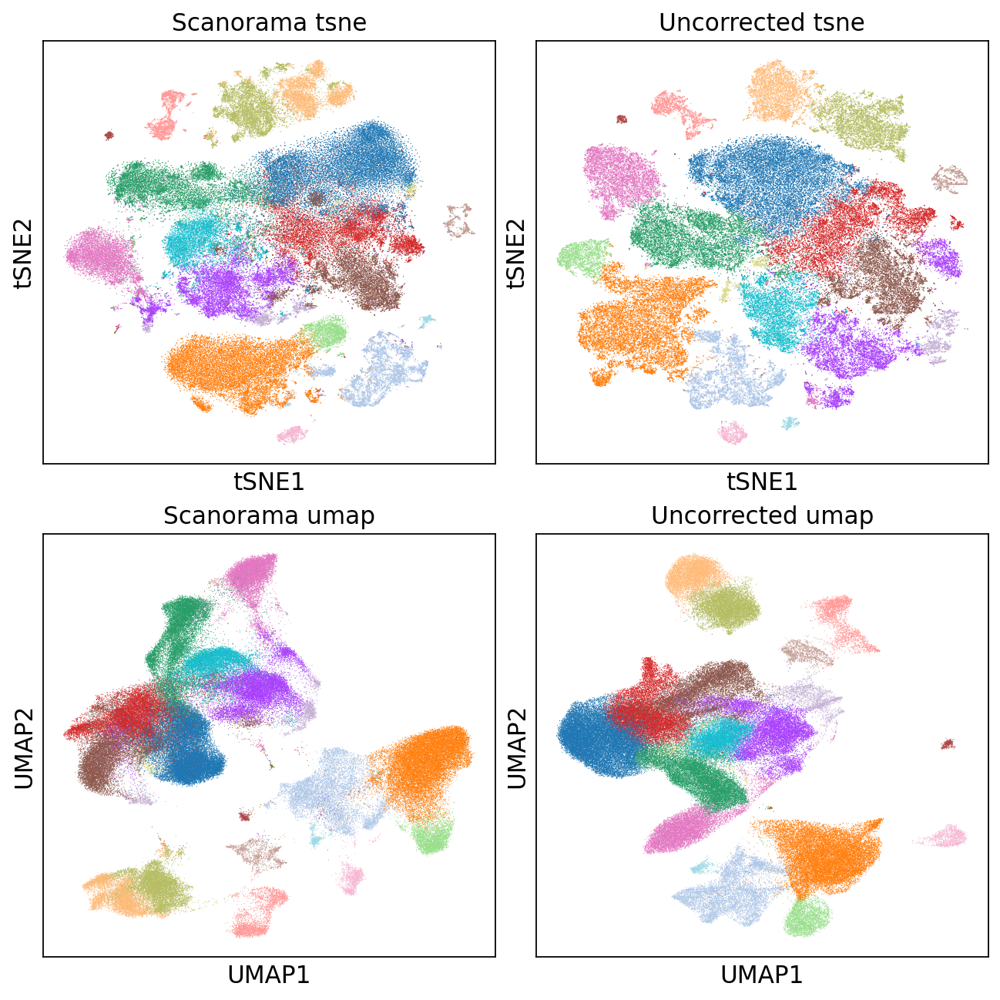

In [55]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_scanorama, color="louvain_0.6", title="Scanorama tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="louvain_0.6", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_scanorama, color="louvain_0.6", title="Scanorama umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="louvain_0.6", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [38]:
adata_scanorama = sc.read_h5ad(save_file_scanorama)
# adata_scanorama.uns['log1p']["base"] = None
adata_scanorama

AnnData object with n_obs × n_vars = 131780 × 24677
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'tsne', 'umap'
    obsm: 'Scanorama', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

In [35]:
#save to file
save_file_scanorama = './Cilio/scanpy_scanorama_corrected_Cillo.h5ad'
adata_scanorama.write_h5ad(save_file_scanorama)

### Harmony

In [209]:
import scanpy.external as sce

In [213]:
adata_harmony

AnnData object with n_obs × n_vars = 60171 × 1288
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cell_barcodes'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'tsne'
    obsm: 'X_pca', 'X_umap', 'X_tsne', 'X_pca_harmony'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [210]:
# create a new object with lognormalized counts
adata_harmony = cillo_adata.copy()

# first store the raw data 
adata_harmony.raw = adata_harmony

# run harmony
sce.pp.harmony_integrate(adata_harmony, key='batch')

2022-06-23 10:54:49,670 - harmonypy - INFO - Iteration 1 of 10
2022-06-23 10:55:44,937 - harmonypy - INFO - Iteration 2 of 10
2022-06-23 10:56:43,167 - harmonypy - INFO - Iteration 3 of 10
2022-06-23 10:57:39,824 - harmonypy - INFO - Iteration 4 of 10
2022-06-23 10:58:35,769 - harmonypy - INFO - Iteration 5 of 10
2022-06-23 10:59:31,034 - harmonypy - INFO - Converged after 5 iterations


In [211]:
# tsne and umap
sc.pp.neighbors(adata_harmony, n_pcs =50, use_rep = "X_pca_harmony")
sc.tl.umap(adata_harmony)
sc.tl.tsne(adata_harmony, n_pcs = 50, use_rep = "X_pca_harmony")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:14)
computing tSNE
    using sklearn.manifold.TSNE


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:04:31)


<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

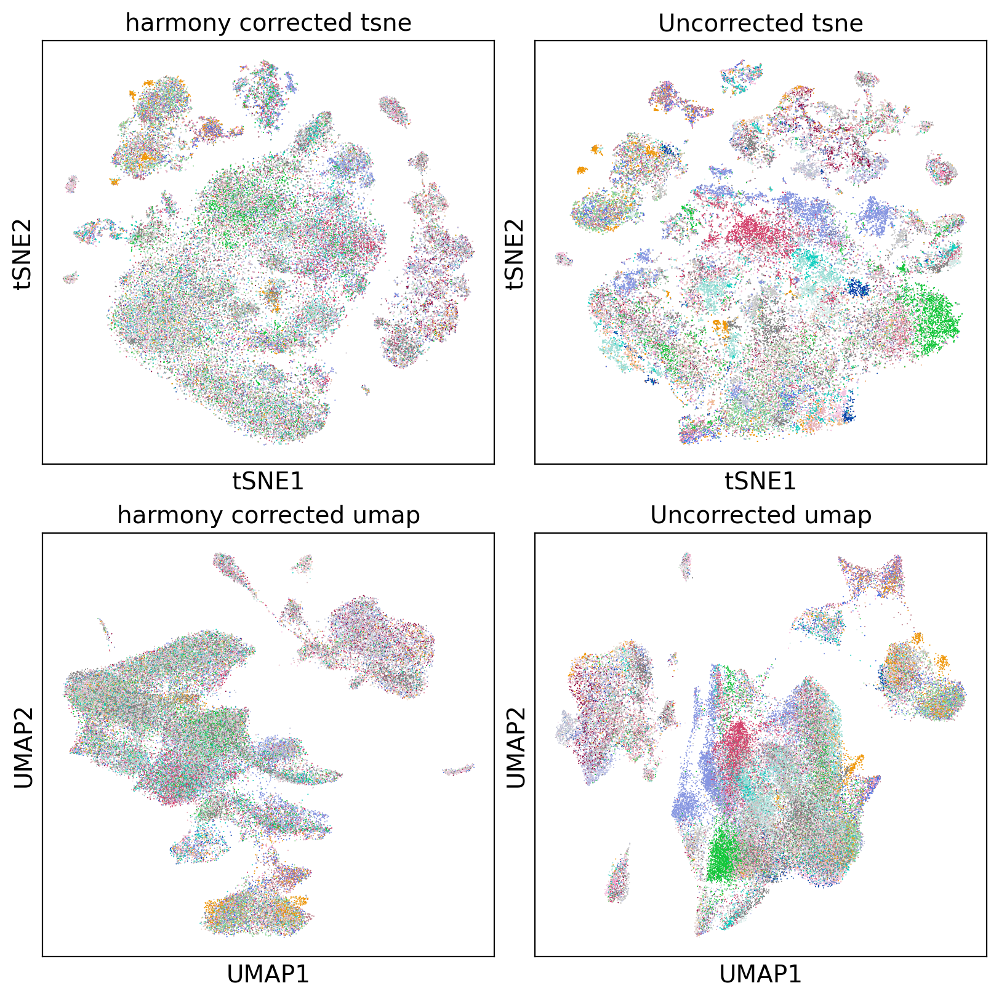

In [212]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_harmony, color="batch", title="harmony corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="batch", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_harmony, color="batch", title="harmony corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="batch", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

KeyError: 'louvain_0.6'

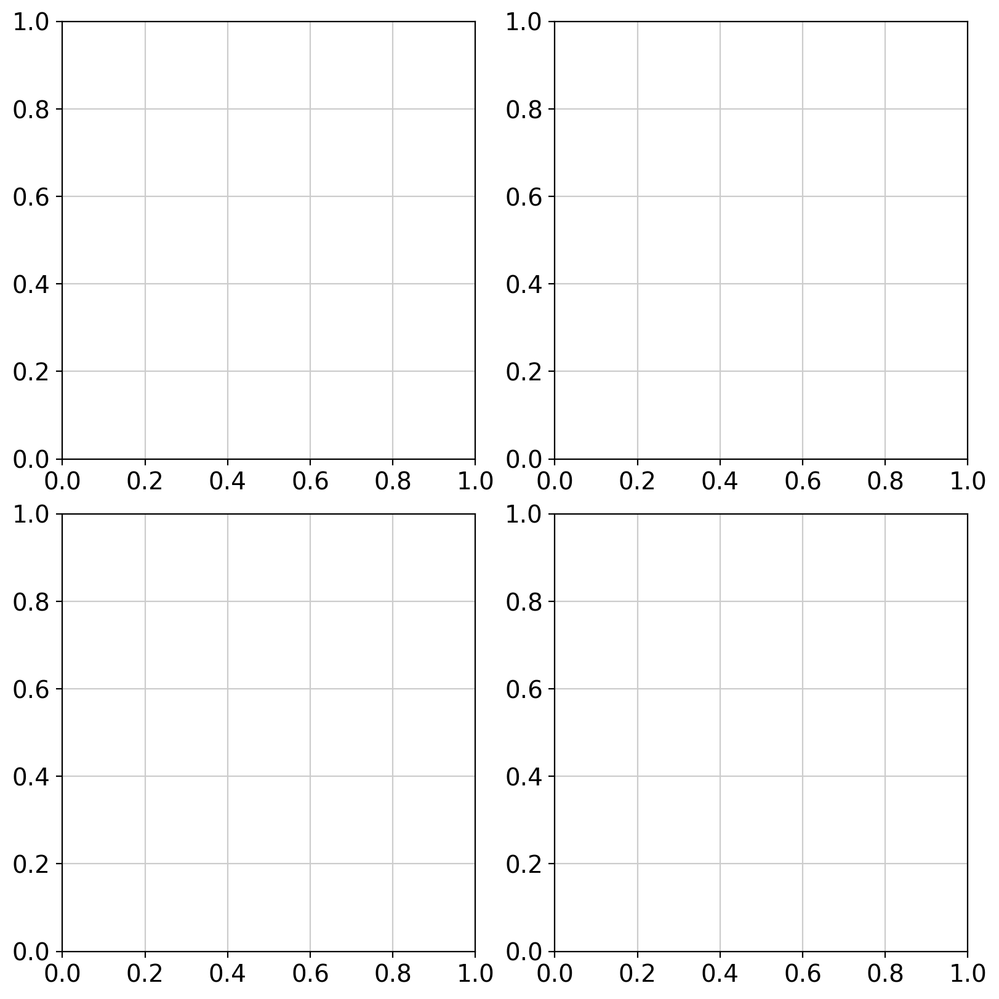

In [214]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_harmony, color="louvain_0.6", title="harmony corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="louvain_0.6", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_harmony, color="louvain_0.6", title="harmony corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="louvain_0.6", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [ ]:
adata_harmony = sc.read_h5ad(save_file_harmony)
# adata_harmony.uns['log1p']["base"] = None
adata_harmony

In [216]:
adata_harmony

AnnData object with n_obs × n_vars = 60171 × 1288
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'percent_chrY', 'XIST-counts', 'doublet_scores', 'predicted_doublets', 'doublet_info', 'cell_barcodes'
    var: 'genesymbol', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'doublet_info_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'tsne'
    obsm: 'X_pca', 'X_umap', 'X_tsne', 'X_pca_harmony'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [215]:
#save to file
save_file_harmony = './Cilio/scanpy_harmony_corrected_Cillo.h5ad'
adata_harmony.write_h5ad(save_file_harmony)

### BBKNN

In [60]:
# create a new object with lognormalized counts
adata_bbknn = cillo_adata.copy()

# first store the raw data 
adata_bbknn.raw = adata_bbknn

# run harmony
sce.pp.bbknn(adata_bbknn, batch_key='batch')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:03:35)


extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 172


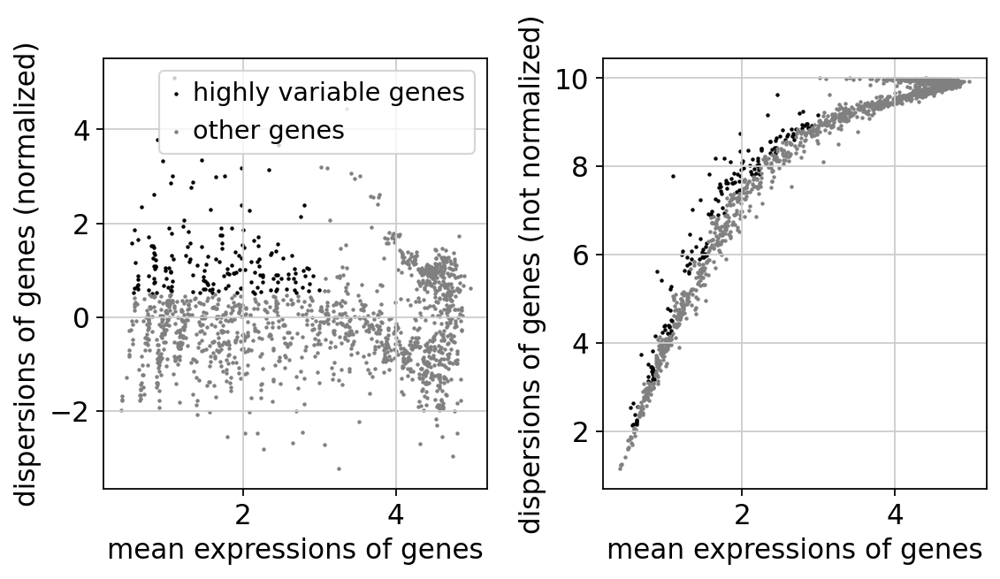

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:05)
computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE


/home/cke/miniconda3/envs/BLADE/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:14:36)


In [61]:
sc.pp.highly_variable_genes(adata_bbknn)
print("Highly variable genes: %d"%sum(adata_bbknn.var.highly_variable))
sc.pl.highly_variable_genes(adata_bbknn)

sc.pp.pca(adata_bbknn, n_comps=30, use_highly_variable=True, svd_solver='arpack')

sc.pp.neighbors(adata_bbknn, n_pcs =30)

sc.tl.umap(adata_bbknn)
sc.tl.tsne(adata_bbknn, n_pcs = 30)

In [63]:
# compare var_genes
var_genes_combat = adata_bbknn.var.highly_variable
print("With all data %d"%sum(var_genes_all))
print("With combat %d"%sum(var_genes_combat))
print("Overlap %d"%sum(var_genes_all & var_genes_combat))

print("With 2 batches %d"%sum(var_select))
print("Overlap %d"%sum(var_genes_combat & var_select))

With all data 1464
With combat 172
Overlap 172
With 2 batches 12396
Overlap 172


<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

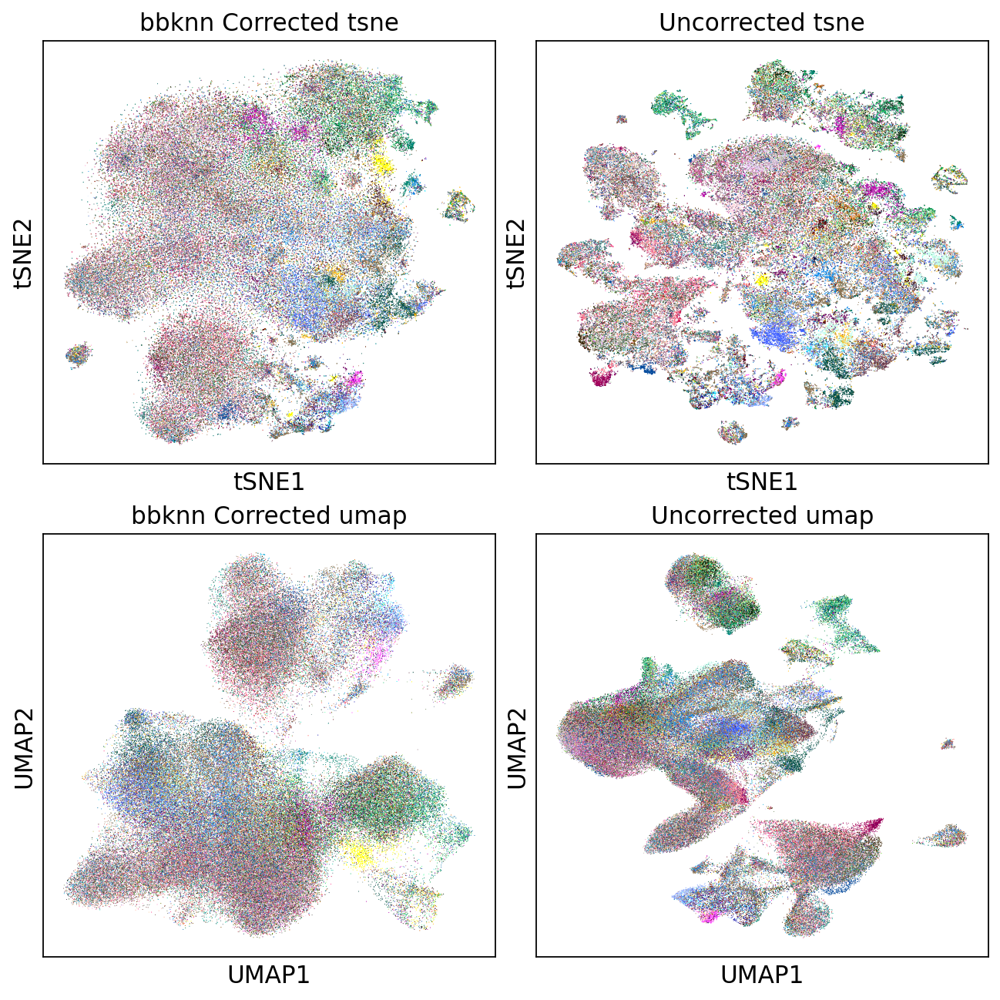

In [64]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_bbknn, color="batch", title="bbknn Corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="batch", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_bbknn, color="batch", title="bbknn Corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="batch", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [ ]:
fig, axs = plt.subplots(2, 2, figsize=(8,8),constrained_layout=True)
sc.pl.tsne(adata_bbknn, color="louvain_0.6", title="bbknn Corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="louvain_0.6", title="Uncorrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.umap(adata_bbknn, color="louvain_0.6", title="bbknn Corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="louvain_0.6", title="Uncorrected umap", ax=axs[1,1], show=False,legend_loc=None)

In [ ]:
adata_bbknn = sc.read_h5ad(save_file_bbknn)
# save_file_bbknn.uns['log1p']["base"] = None
adata_bbknn

In [65]:
#save to file
save_file_bbknn = './Cilio/scanpy_bbknn_corrected_Cillo.h5ad'
adata_bbknn.write_h5ad(save_file_bbknn)

<AxesSubplot:title={'center':'Uncorrected umap'}, xlabel='UMAP1', ylabel='UMAP2'>

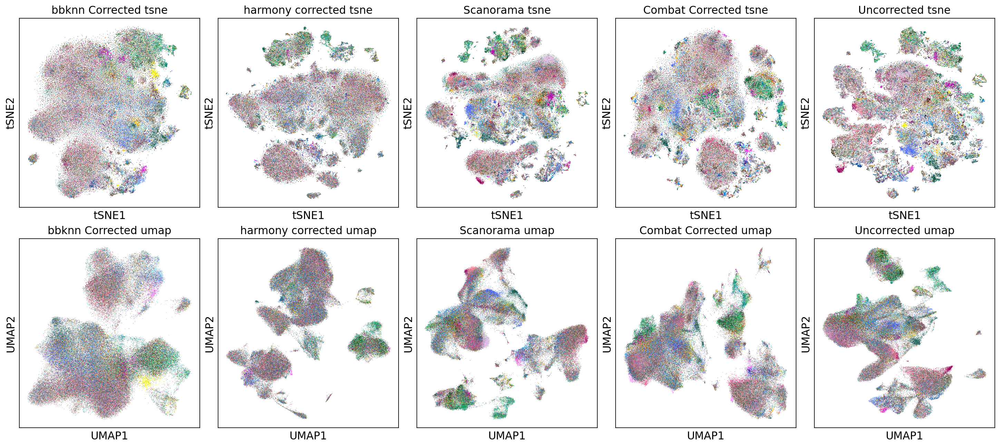

In [71]:
fig, axs = plt.subplots(2, 5, figsize=(18,8),constrained_layout=True)
sc.pl.tsne(adata_bbknn, color="batch", title="bbknn Corrected tsne", ax=axs[0,0], show=False,legend_loc=None)
sc.pl.tsne(adata_harmony, color="batch", title="harmony corrected tsne", ax=axs[0,1], show=False,legend_loc=None)
sc.pl.tsne(adata_scanorama, color="batch", title="Scanorama tsne", ax=axs[0,2], show=False,legend_loc=None)
sc.pl.tsne(adata_combat, color="batch", title="Combat Corrected tsne", ax=axs[0,3], show=False,legend_loc=None)
sc.pl.tsne(cillo_adata, color="batch", title="Uncorrected tsne", ax=axs[0,4], show=False,legend_loc=None)

sc.pl.umap(adata_bbknn, color="batch", title="bbknn Corrected umap", ax=axs[1,0], show=False,legend_loc=None)
sc.pl.umap(adata_harmony, color="batch", title="harmony corrected umap", ax=axs[1,1], show=False,legend_loc=None)
sc.pl.umap(adata_scanorama, color="batch", title="Scanorama umap", ax=axs[1,2], show=False,legend_loc=None)
sc.pl.umap(adata_combat, color="batch", title="Combat Corrected umap", ax=axs[1,3], show=False,legend_loc=None)
sc.pl.umap(cillo_adata, color="batch", title="Uncorrected umap", ax=axs[1,4], show=False,legend_loc=None)

## Clustering

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 25 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:51)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 20 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:42)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:01:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 30 clusters and added
    'louvain_1.4', the cluster labels (adata.obs, categorical) (0:01:02)


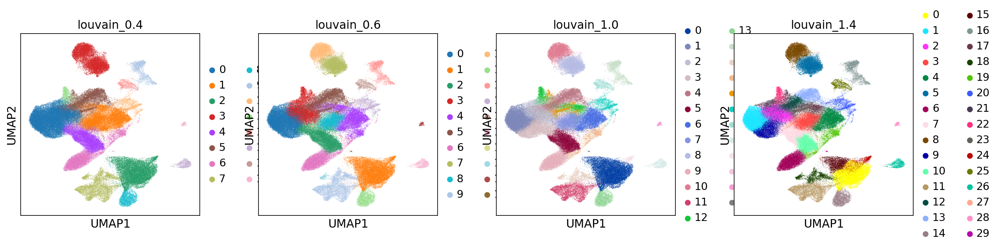

In [132]:
sc.tl.louvain(cillo_adata, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(cillo_adata, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(cillo_adata, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(cillo_adata, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(cillo_adata, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

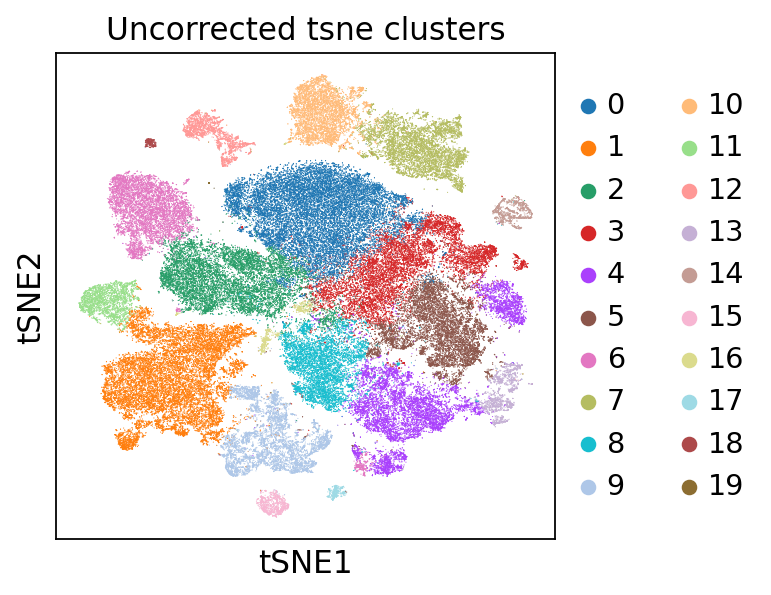

In [72]:
sc.pl.tsne(cillo_adata, color='louvain_0.6',title="Uncorrected tsne clusters")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:59)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:37)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:00:30)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 20 clusters and added
    'louvain_1.4', the cluster labels (adata.obs, categorical) (0:00:26)


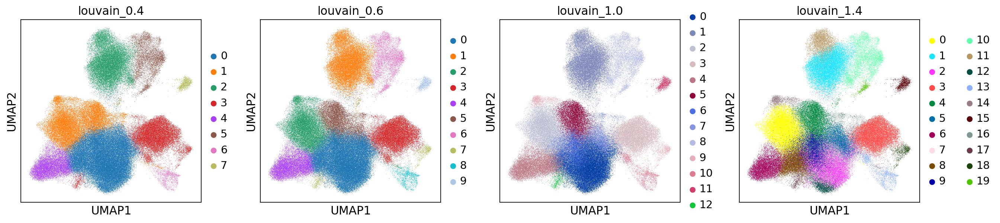

In [74]:
sc.tl.louvain(adata_bbknn, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata_bbknn, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata_bbknn, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata_bbknn, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata_bbknn, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

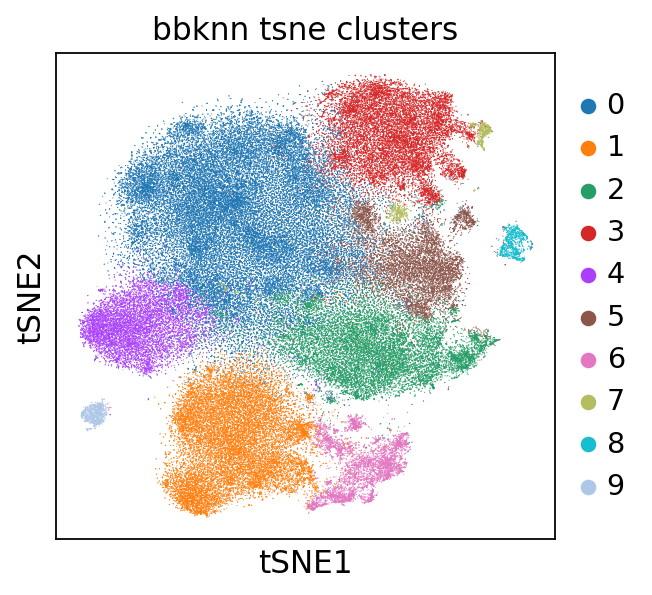

In [75]:
sc.pl.tsne(adata_bbknn, color='louvain_0.6',title="bbknn tsne clusters")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 19 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:55)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:40)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:00:32)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 24 clusters and added
    'louvain_1.4', the cluster labels (adata.obs, categorical) (0:00:32)


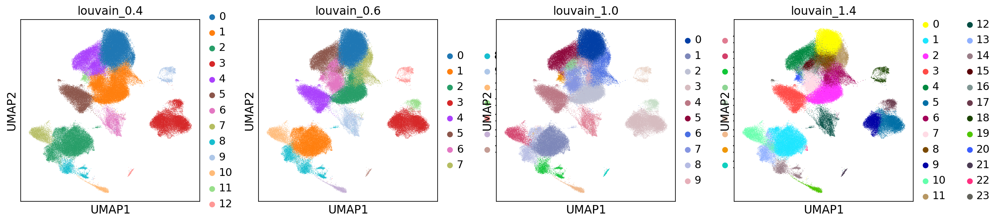

In [76]:
sc.tl.louvain(adata_harmony, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata_harmony, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata_harmony, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata_harmony, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata_harmony, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

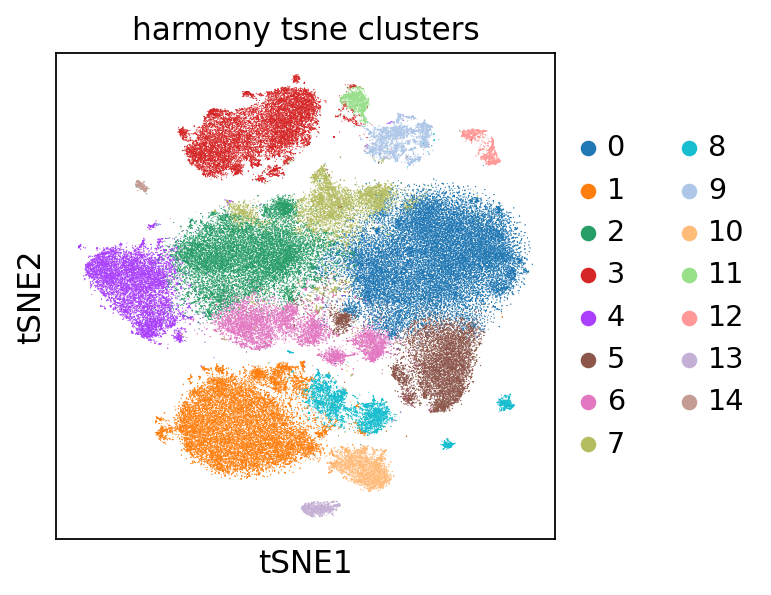

In [83]:
sc.pl.tsne(adata_harmony, color='louvain_0.6',title="harmony tsne clusters")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 22 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:30)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:39)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:00:23)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 26 clusters and added
    'louvain_1.4', the cluster labels (adata.obs, categorical) (0:00:30)


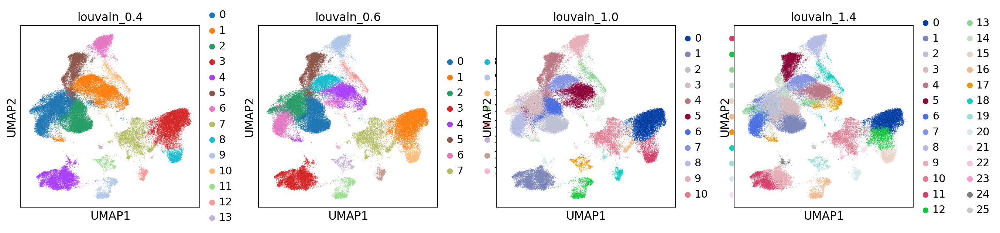

In [79]:
sc.tl.louvain(adata_scanorama, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata_scanorama, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata_scanorama, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata_scanorama, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata_scanorama, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

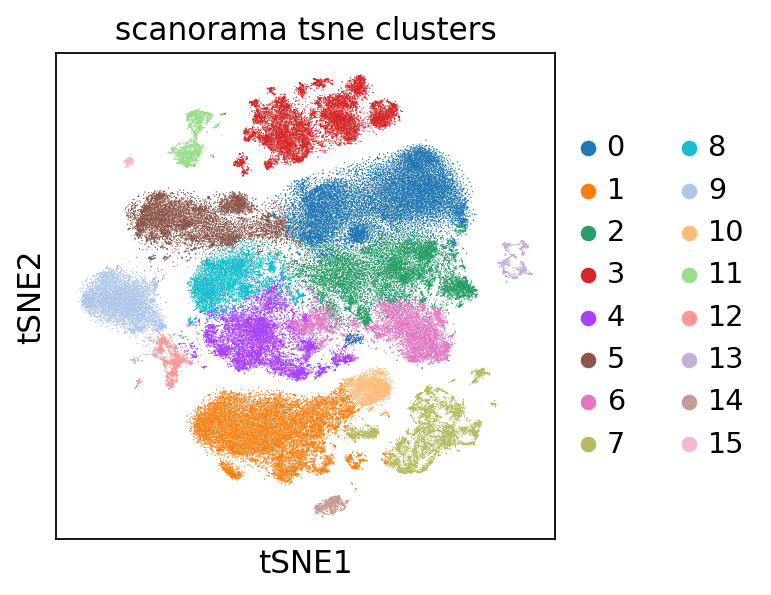

In [80]:
sc.pl.tsne(adata_scanorama, color='louvain_0.6',title="scanorama tsne clusters")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:27)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:25)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:00:29)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 23 clusters and added
    'louvain_1.4', the cluster labels (adata.obs, categorical) (0:00:28)


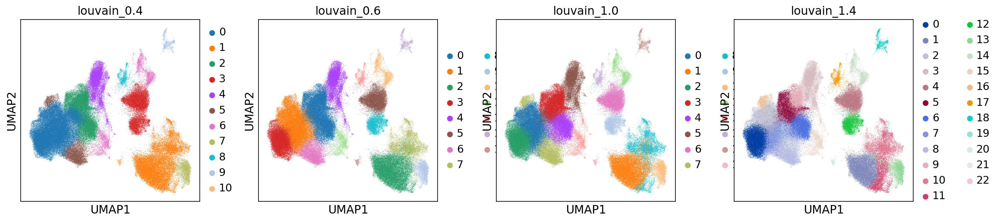

In [81]:
sc.tl.louvain(adata_combat, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata_combat, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata_combat, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata_combat, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata_combat, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

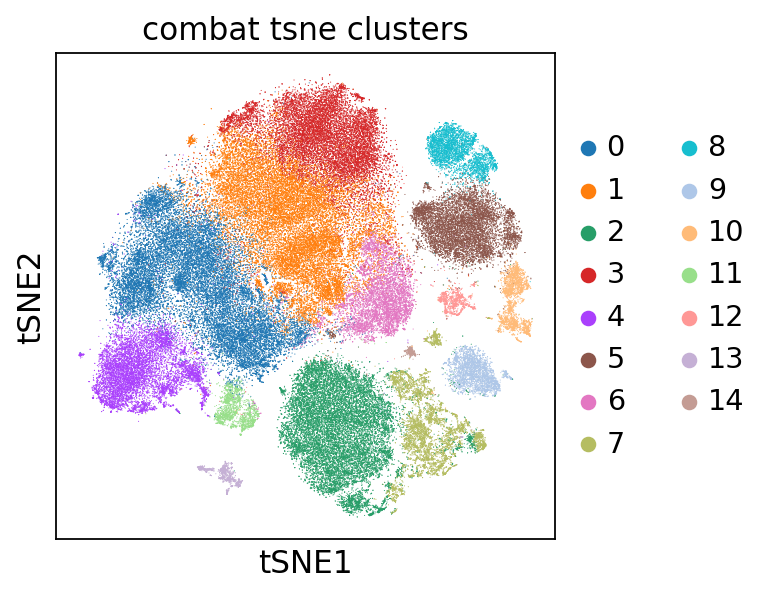

In [82]:
sc.pl.tsne(adata_combat, color='louvain_0.6',title="combat tsne clusters")

#### Fit-SNE (not making any difference)

In [141]:
import fitsne

In [149]:
# FIT-SNE plot
print(cillo_adata.X.shape)
# Do PCA and keep 50 dimensions
X = cillo_adata.X - cillo_adata.X.mean(axis=0)
U, s, V = np.linalg.svd(X, full_matrices=False)
X50 = np.dot(U, np.diag(s))[:,:50]

(131780, 1464)


In [155]:
X50=np.ascontiguousarray(X50).astype('double')

In [180]:
np.array(cillo_adata.uns['louvain_0.6_colors'])

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a',
       '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d', '#9edae5',
       '#ad494a', '#8c6d31'], dtype='<U7')

In [189]:
dict_color = {}
for i in range(len(np.array(cillo_adata.uns['louvain_0.6_colors']))):
    dict_color[str(i)] = cillo_adata.uns['louvain_0.6_colors'][i]

In [190]:
dict_color

{'0': '#1f77b4',
 '1': '#ff7f0e',
 '2': '#279e68',
 '3': '#d62728',
 '4': '#aa40fc',
 '5': '#8c564b',
 '6': '#e377c2',
 '7': '#b5bd61',
 '8': '#17becf',
 '9': '#aec7e8',
 '10': '#ffbb78',
 '11': '#98df8a',
 '12': '#ff9896',
 '13': '#c5b0d5',
 '14': '#c49c94',
 '15': '#f7b6d2',
 '16': '#dbdb8d',
 '17': '#9edae5',
 '18': '#ad494a',
 '19': '#8c6d31'}

In [192]:
colors = cillo_adata.obs['louvain_0.6'].map(dict_color)
colors

AAACCTGAGCTTTGGT-1-0     #17becf
AAACCTGCAAACCTAC-1-0     #d62728
AAACCTGCACTTCTGC-1-0     #d62728
AAACCTGTCAAGATCC-1-0     #9edae5
AAACGGGAGAATTGTG-1-0     #c49c94
                          ...   
TTTGGTTTCTACCTGC-1-62    #aec7e8
TTTGGTTTCTTGCATT-1-62    #e377c2
TTTGTCAAGGTGCACA-1-62    #17becf
TTTGTCAGTTAAGATG-1-62    #aa40fc
TTTGTCATCAGTGCAT-1-62    #8c564b
Name: louvain_0.6, Length: 131780, dtype: category
Categories (20, object): ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', ..., '#dbdb8d', '#9edae5', '#ad494a', '#8c6d31']

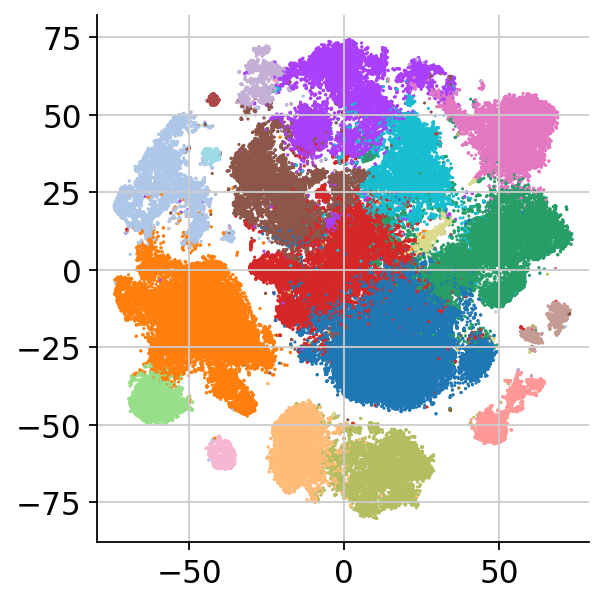

In [193]:
Z_fitsne = fitsne.FItSNE(X50)
plt.figure(figsize=(4,4))
plt.axis('equal')
plt.scatter(Z_fitsne[:,0], Z_fitsne[:,1], c=colors , s=2, edgecolors='none')
sns.despine()
plt.tight_layout()
# Unable to present identical tsne plot as the Cillo publication showed

## Differential expression

In [201]:
# For DGE analysis we would like to run with all genes, 
# but on normalized values, so we will have to revert back to the raw matrix and renormalize.
cillo_adata = cillo_adata.raw.to_adata()
sc.pp.normalize_per_cell(cillo_adata, counts_per_cell_after=1e4)
sc.pp.log1p(cillo_adata)


normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


ranking genes
    finished: added to `.uns['wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:08:41)


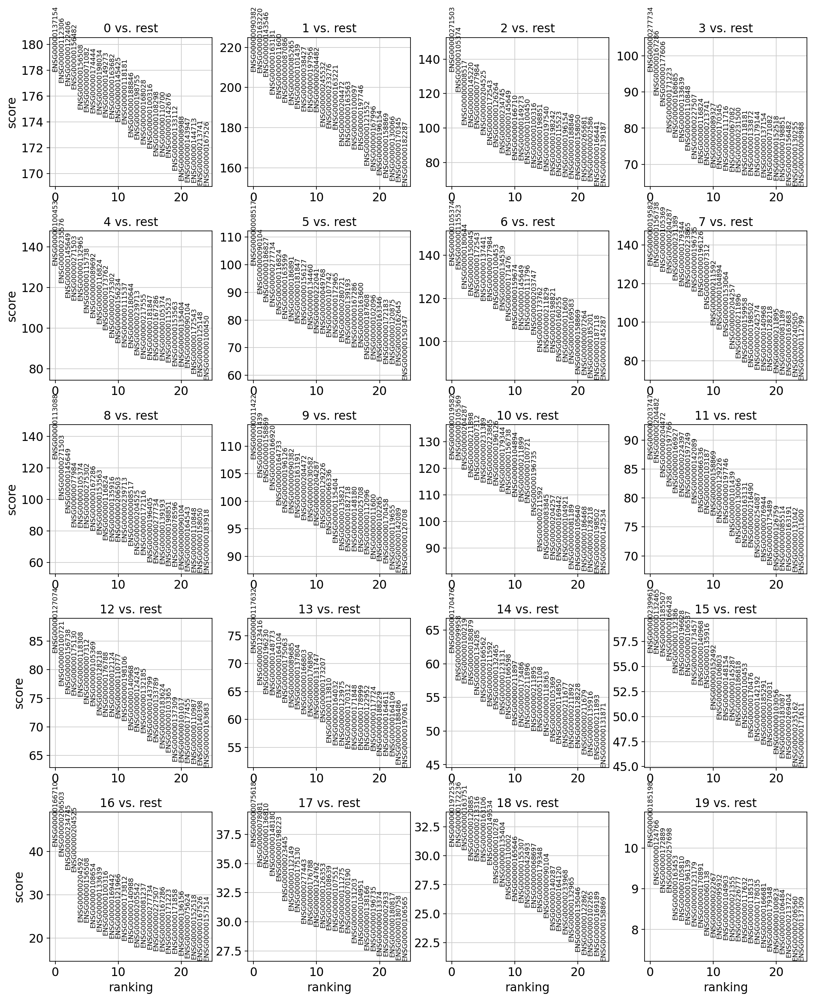

In [202]:
sc.tl.rank_genes_groups(cillo_adata, 'louvain_0.6', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(cillo_adata, n_genes=25, sharey=False, key="wilcoxon")

In [197]:
cillo_adata.write(results_file)

## DEPRECATED OR TEST ONLY BELOW